In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from statsmodels.graphics.gofplots import qqplot
from sklearn.preprocessing import LabelEncoder
from scipy.stats import chi2_contingency
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
from time import time
from sklearn.impute import SimpleImputer
from scipy import stats
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.utils import resample
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.under_sampling import TomekLinks 
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import missingno as msno
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss

# <font color = Red> Train set

# <font color = Purple> Lets explore train set

# Exploratory Data Analysis

In [2]:
banking_train= pd.read_csv("/.../.../.../banking_train.csv")

In [3]:
def EDA(data):
    #get shape of the data
    #checking for null values
    #distribution of the target variable
    #check for duplicate
    # check for empty strings
    print(f'''
    \n------------------------------------------------\n

    \nShape of the data:\n{data.shape}
    \n------------------------------------------------\n

    \n Null Values:\n{data.isnull().sum()} 
    \n------------------------------------------------\n

    \nDistribution of the target variable y: has the client subscribed a term deposit? (binary: "yes","no"):\n{data['y'].value_counts()}
    \nVisualizing the distribution\n 
    ''' )
    plot= sns.countplot(data['y'])
    plot.set_title("Distribution of the target variable Y")
    plt.show()
    
    print(f'''
    \n------------------------------------------------\n
    \nDuplicated data:\n{ data.duplicated().sum()} 
    \n------------------------------------------------\n

    \n Empty strings:\n{np.where(data.applymap(lambda x: x==" "))}\n
    ''' )

   



    
------------------------------------------------


    
Shape of the data:
(45211, 17)
    
------------------------------------------------


    
 Null Values:
age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64 
    
------------------------------------------------


    
Distribution of the target variable y: has the client subscribed a term deposit? (binary: "yes","no"):
no     39922
yes     5289
Name: y, dtype: int64
    
Visualizing the distribution
 
    


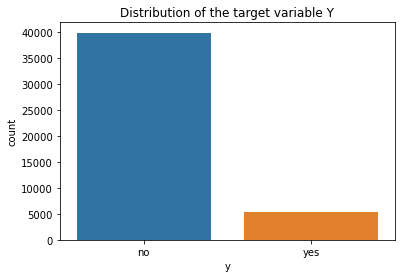


    
------------------------------------------------

    
Duplicated data:
0 
    
------------------------------------------------


    
 Empty strings:
(array([], dtype=int64), array([], dtype=int64))

    


In [4]:
EDA(banking_train)

In [5]:
banking_train.info()# detalied info about each variable



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


# Lets explore continous and categorical features separately 

In [6]:
continous=[]
categorical=[]
for feature in banking_train.columns:
    if banking_train[feature].dtype  == 'int64':
        continous.append(feature)
    else:
        categorical.append(feature)

# <font color = Purple> Exploring Continous Features </font>

In [9]:
# lets explore continous features by dropping categorical feat and elave only continous
banking_train.drop(categorical, axis=1, inplace= True)# set axis to 1 so you drop the whole columns


In [13]:
banking_train.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


In [ ]:
# lets check for multicolinarity 
banking_train.corr()

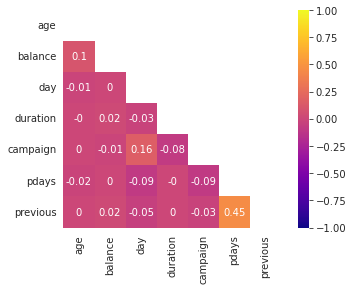

In [15]:
# lets visulize  as it become easier to read
# create mask
mask= np.zeros_like(banking_train.corr(), dtype= bool)
mask[np.triu_indices_from(mask)]= True

with sns.axes_style("white"):
    ax = sns.heatmap(round(banking_train.corr(),2), mask=mask, vmin=-1, vmax=1, square=True, cmap = 'plasma',annot= True)

plt.show()

- There is a correlation btw pdays and previous (r= 0.45)
- There is a correlation btw campaign and day (r=0.16) 


# Plot Histogram and box plot for continous features

In [ ]:
# plot distribution plot for continous features

for i in continous:
    fig=px.histogram(banking_train[i], x = i, marginal='box',nbins=10)
    fig.show()
    
    

# <font color= Green>Exploring Categorical Features</font>

In [33]:
banking_train= pd.read_csv("/.../.../.../banking_train.csv")

In [34]:
banking_train.drop(continous, axis=1, inplace=True)


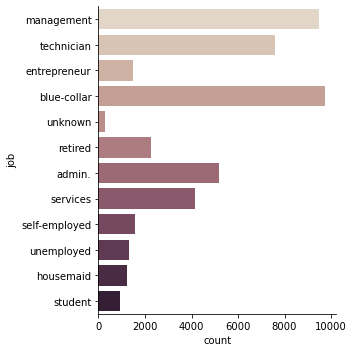

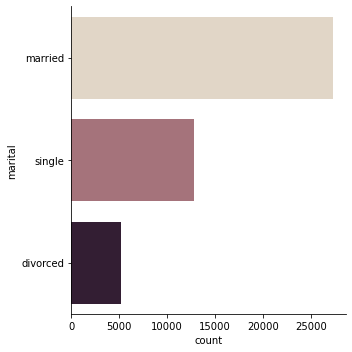

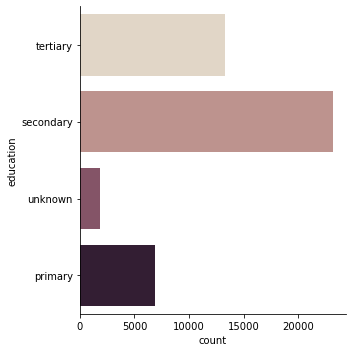

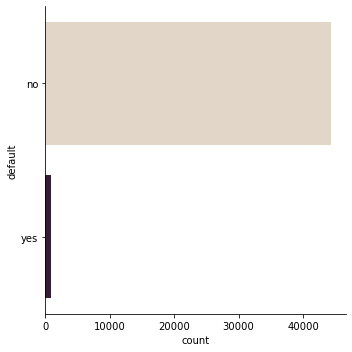

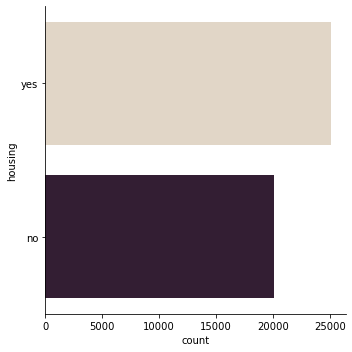

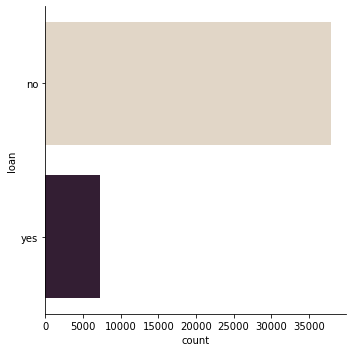

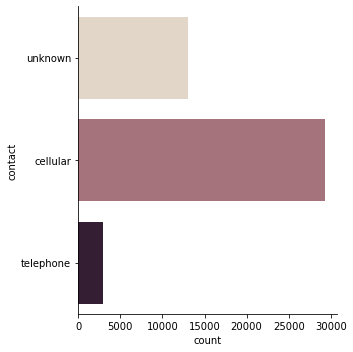

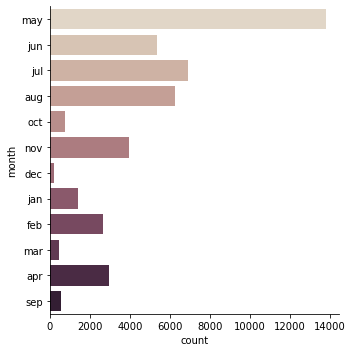

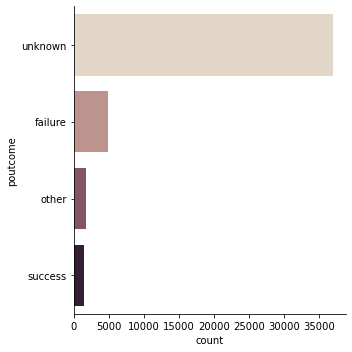

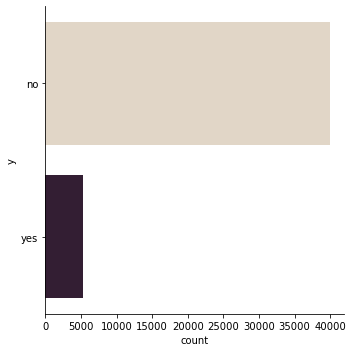

In [20]:
for feature in banking_train.columns:
    sns.catplot(y=feature, kind='count', palette='ch:.25', data=banking_train)

In [21]:
# unique values
for col in banking_train.columns:
    print(f"""{col} : {banking_train[col].nunique()} Unique Values 
              \n  --Which are: {banking_train[col].unique()}\n 
              """)


job : 12 Unique Values 
              
  --Which are: ['management' 'technician' 'entrepreneur' 'blue-collar' 'unknown'
 'retired' 'admin.' 'services' 'self-employed' 'unemployed' 'housemaid'
 'student']
 
              
marital : 3 Unique Values 
              
  --Which are: ['married' 'single' 'divorced']
 
              
education : 4 Unique Values 
              
  --Which are: ['tertiary' 'secondary' 'unknown' 'primary']
 
              
default : 2 Unique Values 
              
  --Which are: ['no' 'yes']
 
              
housing : 2 Unique Values 
              
  --Which are: ['yes' 'no']
 
              
loan : 2 Unique Values 
              
  --Which are: ['no' 'yes']
 
              
contact : 3 Unique Values 
              
  --Which are: ['unknown' 'cellular' 'telephone']
 
              
month : 12 Unique Values 
              
  --Which are: ['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'jan' 'feb' 'mar' 'apr' 'sep']
 
              
poutcome : 4 Unique Values 
          

- ###  job, education, poutcome, and contact have unknowns; will treat as missing values. all will replaced by np.nan first then treated


# Cramer's V  Matrix
- Lets check for association btw categorical features using Cramers V correlation matrix
- Adapted from https://stackoverflow.com/questions/46498455/categorical-features-correlation/46498792#46498792

# <font color = Purple> Label Encoding</font>

In [22]:
label = LabelEncoder()
data_encoded = pd.DataFrame()

In [23]:
for feature in banking_train.columns:
    data_encoded[feature]= label.fit_transform(banking_train[feature])

In [24]:
# lets check to see if successeded in encoding our catgorical feat
data_encoded.head()

,job,marital,education,default,housing,loan,contact,month,poutcome,y
0,4,1,2,0,1,0,2,8,3,0
1,9,2,1,0,1,0,2,8,3,0
2,2,1,1,0,1,1,2,8,3,0
3,1,1,3,0,1,0,2,8,3,0
4,11,2,3,0,0,0,2,8,3,0


In [25]:
#Cramer V function
def cramers_V(var1,var2) :
    crosstab =np.array(pd.crosstab(var1,var2, rownames=None, colnames=None)) # Cross tablulation 
    x2 = chi2_contingency(crosstab)[0] # Keeping of the test statistic of the Chi2 test
    n= np.sum(crosstab)
    phi2= x2/n
    r, k =crosstab.shape
    phi2corr= max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1) 
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [26]:
rows= []

for var1 in data_encoded:
    col = []
    for var2 in data_encoded :
        cramers =cramers_V(data_encoded[var1], data_encoded[var2]) # Cramer's V test
        col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V  
    rows.append(col)

cramers_results = np.array(rows)
banking_train = pd.DataFrame(cramers_results, columns = data_encoded.columns, index =data_encoded.columns)




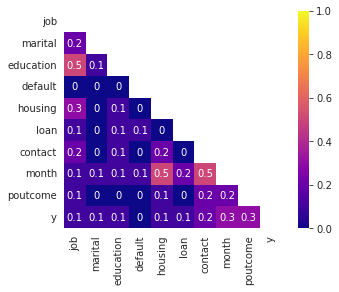

In [27]:
mask = np.zeros_like((round(banking_train,1)), dtype=bool)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("white"):
    fig = sns.heatmap((round(banking_train,1)), mask=mask,vmin=0., vmax=1, square=True, cmap = 'plasma',annot= True)
plt.savefig("/.../.../.../img/Cramer's V Before cleaning.png")
plt.show()

# <font color =Blue>Data Cleaning</font>

# <font color = brown>Summary:</font>

- ### <font color = brown> we have a mix of continous and categorical features

- ### <font color = brown> null values:</font> although no explicit null values, but  the variables job, poutcome,  contact ,and education have unkowns which we will treat as null values. will replace unknown with nan. 
    




- ### <font color = brown> Dataset is imbalanced: more no than yes

- ### Detect outliers in contious variables 
    
- ### There is a correlation btw pdays and previous (r= 0.45). consider dropping one of them and check if that will improve the performance of the model
- ### There is a correlation btw campaign and day (r=0.16). consider dropping one of them and check if that will improve the performance of the model
 
    
- ### There is an association btween housing and month (0.5). consider dropping one of them and check if that will improve the performance of the model
- ### There is an association btween contact and month (0.5). consider dropping one of them and check if that will improve the performance of the model
- ### There is an association btween education and job (0.5). consider dropping one of them and check if that will improve the performance of the model



In [37]:
banking_train= pd.read_csv("/.../.../.../banking_train.csv")

In [38]:
# print out first 5 rows
banking_train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


In [39]:
#job which is categorical replace "unknown",with nan
banking_train['job']= banking_train['job'].replace("unknown", np.nan)

In [40]:
#replace "unknown",with nan

banking_train['contact']= banking_train['contact'].replace("unknown", np.nan)

In [41]:
#replace "unknown",with nan


banking_train['poutcome']= banking_train['poutcome'].replace("unknown", np.nan)

In [42]:
# replace "unknown",with nan

banking_train['education']= banking_train['education'].replace("unknown", np.nan)

In [43]:
banking_train.isnull().sum()

age              0
job            288
marital          0
education     1857
default          0
balance          0
housing          0
loan             0
contact      13020
day              0
month            0
duration         0
campaign         0
pdays            0
previous         0
poutcome     36959
y                0
dtype: int64

In [95]:
banking_train.shape

(45211, 17)

# <font color = Brown> Before treating null values lets check if they are:
    
    - Missing Completly at random (MCAR): Missing completely at random; there is no relationship between existing values and missing values 
    
    - or Missingness at Random (MAR): 
    
    - or Not missing at random (NMAR):

<AxesSubplot:>

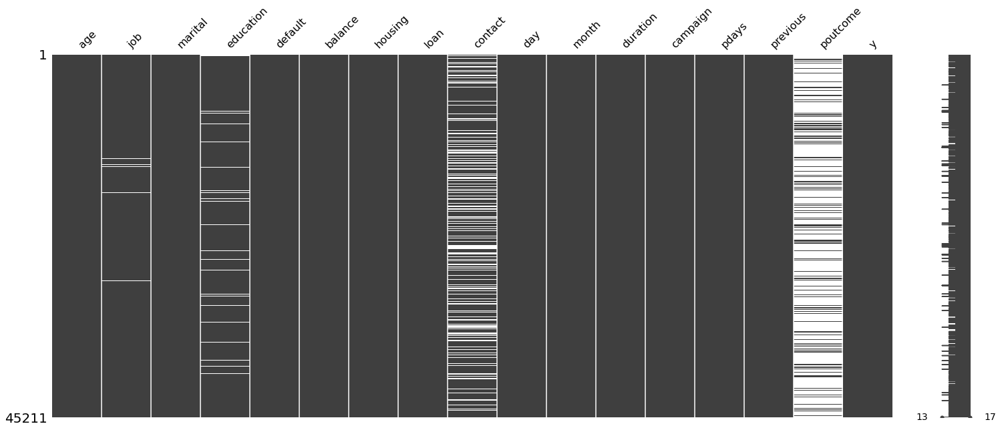

In [100]:
msno.matrix(banking_train.sample(45211))

<AxesSubplot:>

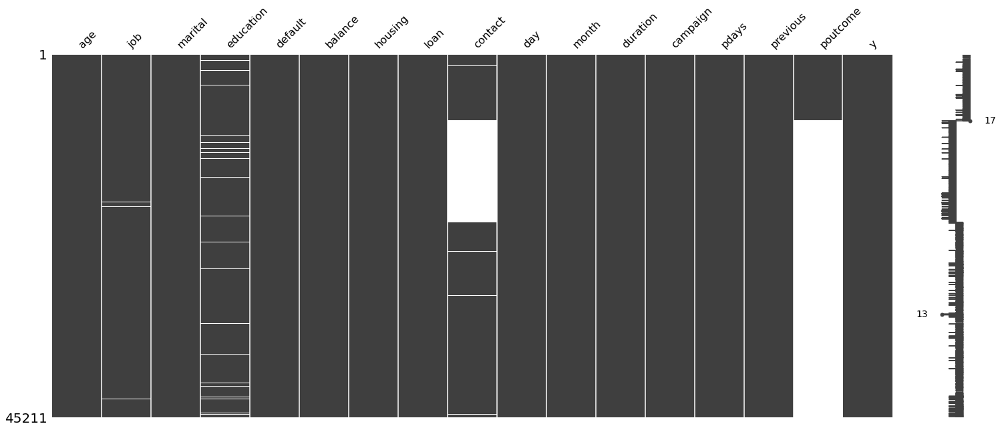

In [101]:
msno.matrix(banking_train.sort_values('poutcome'))

<AxesSubplot:>

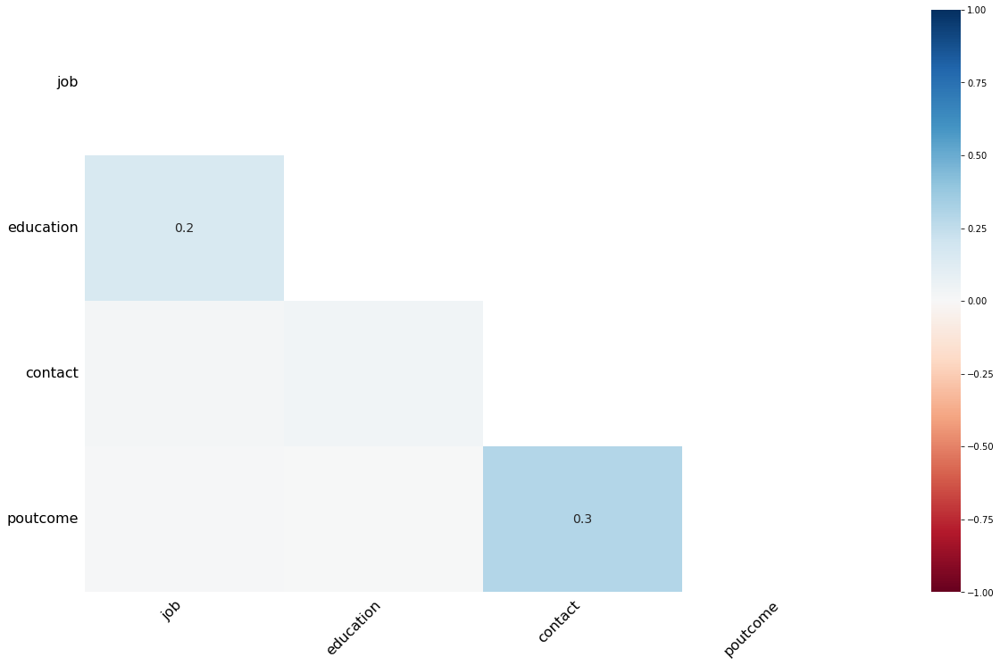

In [102]:
# Lets measure nullity correlation:how strongly the presence or absence of one variable affects the presence of another

msno.heatmap(banking_train)

<AxesSubplot:>

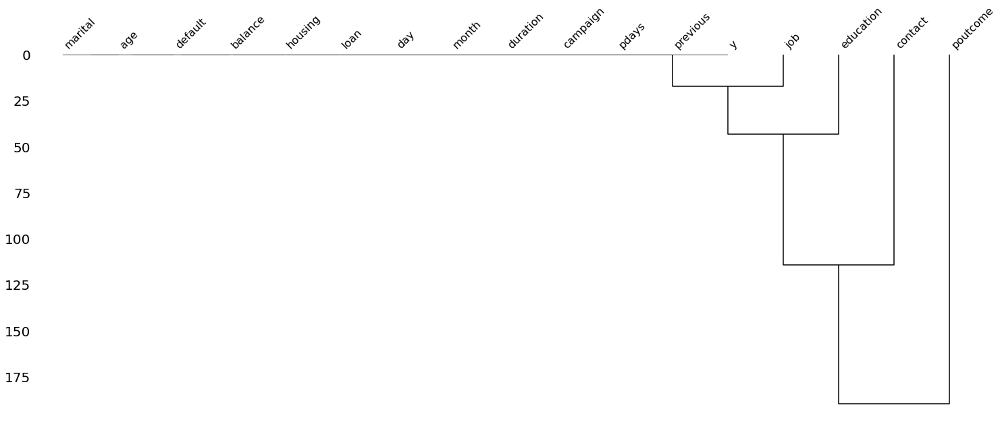

In [103]:
#reveals trends deeper than the pairwise ones visible in the correlation heatmap
msno.dendrogram(banking_train)

# <font color =Blue>  Missing at random

In [44]:
for feature in banking_train:
    if pd.isna(banking_train[feature]).sum() > 0:
        print(f'{feature} has {banking_train[feature].isnull().sum()} Null values')
   

job has 288 Null values
education has 1857 Null values
contact has 13020 Null values
poutcome has 36959 Null values


In [106]:
# will drop poutcome as it has so many missing values
banking_train.drop('poutcome', axis=1, inplace= True)

In [107]:
# make sure poutcome dropped
banking_train.head(2)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,no


In [108]:
# for the rest, we treat missing values by dropping any rows with missing values 
banking_train.dropna(axis=0, how='any',inplace=True)

In [109]:
banking_train.shape

(30907, 16)

In [110]:
banking_train.to_csv("/.../.../.../banking_train_imputed.csv", index=False)

# Lets re examine categorical features after Cleaning Null values

In [111]:
banking_train.drop(continous, axis=1, inplace=True)

In [112]:
banking_train.columns

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'y'],
      dtype='object')

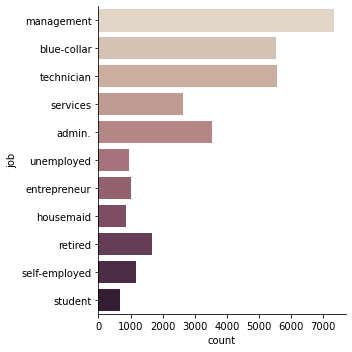

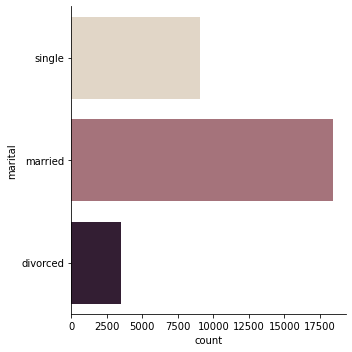

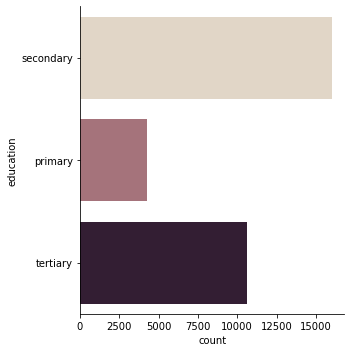

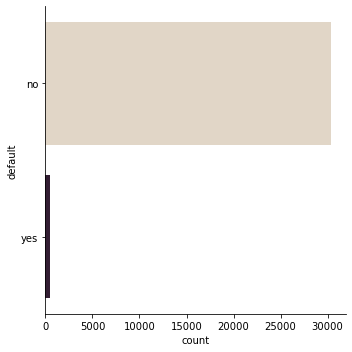

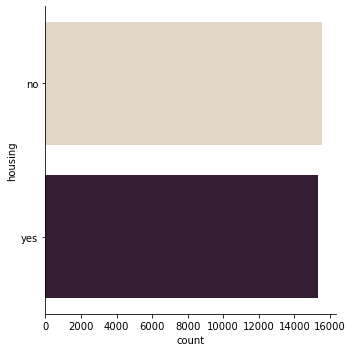

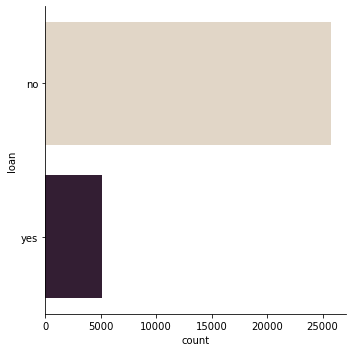

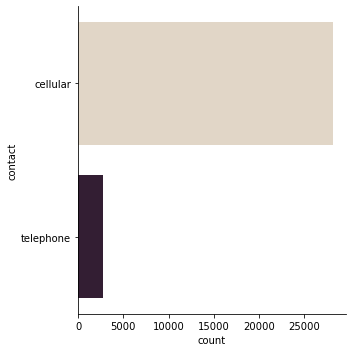

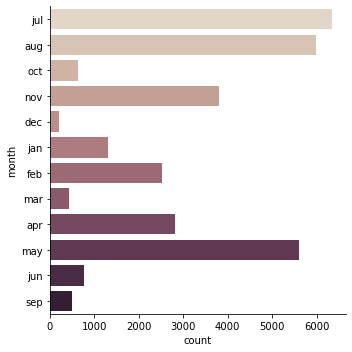

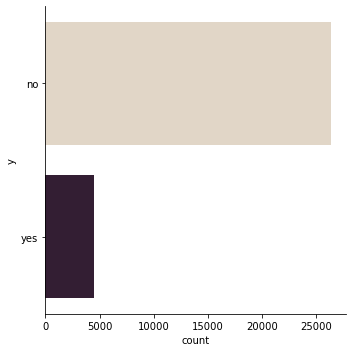

In [113]:
for feature in banking_train.columns:
    sns.catplot(y=feature, kind='count', palette='ch:.25', data=banking_train)

In [114]:
label = LabelEncoder()
data_encoded = pd.DataFrame()

In [115]:
for feature in banking_train.columns:
    data_encoded[feature]= label.fit_transform(banking_train[feature])

In [116]:
# lets check to see if successeded in encoding our catgorical feat
data_encoded.head()

,job,marital,education,default,housing,loan,contact,month,y
0,4,2,1,0,0,0,0,5,0
1,1,1,0,0,0,0,0,5,0
2,1,1,1,0,0,1,0,5,0
3,9,2,1,0,0,0,1,5,0
4,9,2,1,0,1,1,0,5,0


In [117]:
#Cramer V function
def cramers_V(var1,var2) :
    crosstab =np.array(pd.crosstab(var1,var2, rownames=None, colnames=None)) # Cross tablulation 
    x2 = chi2_contingency(crosstab)[0] # Keeping of the test statistic of the Chi2 test
    n= np.sum(crosstab)
    phi2= x2/n
    r, k =crosstab.shape
    phi2corr= max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1) 
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [118]:
rows= []

for var1 in data_encoded:
    col = []
    for var2 in data_encoded :
        cramers =cramers_V(data_encoded[var1], data_encoded[var2]) # Cramer's V test
        col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V  
    rows.append(col)

cramers_results = np.array(rows)
banking_train = pd.DataFrame(cramers_results, columns = data_encoded.columns, index =data_encoded.columns)




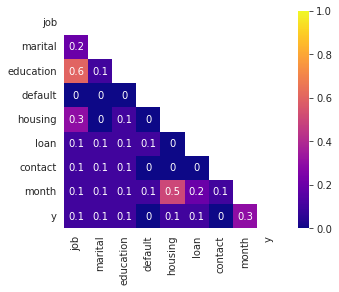

In [119]:
mask = np.zeros_like((round(banking_train,1)), dtype=bool)
mask[np.triu_indices_from(mask)] = True




with sns.axes_style("white"):
    fig = sns.heatmap((round(banking_train,1)), mask=mask,vmin=0., vmax=1, square=True, cmap = 'plasma',annot= True)
plt.savefig("/.../.../.../img/Cramer's V after cleaning.png")
plt.show()

# Lets compare correlation before and after cleaning unknowns(age, education, poutcome, and contact have unknowns that we treated as missing and removed from data)

# Before
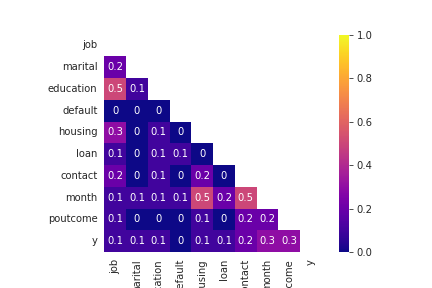


# After


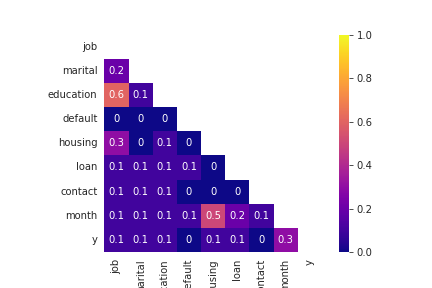

In [121]:
banking_train= pd.read_csv("/.../.../.../Banking Dataset/banking_train.csv")

### - Weak association between categorical features and target variable
### - association btw target variable and contact dropped after dropping unkowns 
### - association between month and contact decreased from 0.5 to 0.1
### - association between contact and job decreased 0.2 to 0.1
### - association between contact and housing decreased from 0.2 to 0
### - association between education and job inceased from 0.5 to 0.6
### - association between loan and contact with martial increased from 0 to 0.1



In [122]:
banking_train.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64

In [ ]:
banking_train=pd.read_csv("/.../.../.../banking_train_imputed.csv")

In [ ]:
banking_train.sample()

# <font color = Red> Using Z-score and BoxPlot to Detect Outliers
<font color = green> z-score referes to how many standard of deviations (std) a data point is above or below the mean

<font color = green>$ Z-Score = \frac{(x-\mu)}{\sigma} $

<font color = green>where, 
<font color = green>$x$ = $data$ $point$

<font color = green><font color = green> $\mu = mean$

<font color = green> $\sigma = std$


In [131]:
# Adapted from Derek Jedamski
def detect_outlier(feature):
    outliers = []
    data = banking_train[feature]
    mean = np.mean(data)
    std = np.std(data)
    
    for y in data:
        z_score = (y - mean)/std
        if np.abs(z_score) > 3:
            outliers.append(y)
    print(f'\nOutlier caps for {feature}:')
    print(f'  95p: {data.quantile(.95)}')                                 
    print(f'  3sd: {mean + 3*(std)}' )
    print(f'  99p: {data.quantile(.99)}')
    print(f'\nOutlier floor for {feature}:')                                                      
    print(f'  0.5p: {data.quantile(.05)}')                                 
    print(f'  3sd: {mean - 3*(std)}')
    print(f'  1: {data.quantile(.01)}')
    fig = px.histogram(banking_train, x =feature, marginal='box')
    fig.show()





In [ ]:
continous

In [133]:
# Determine what the upperbound and lowerbound should be for continous features
for feat in continous:
    detect_outlier(feat)



Outlier caps for age:
  95p: 59.0
  3sd: 73.6861363712177
  99p: 73.0

Outlier floor for age:
  0.5p: 27.0
  3sd: 8.1516997176942
  1: 23.0



Outlier caps for balance:
  95p: 5969.0
  3sd: 10998.506922917477
  99p: 13711.0

Outlier floor for balance:
  0.5p: -113.0
  3sd: -8146.985519999045
  1: -559.0



Outlier caps for day:
  95p: 30.0
  3sd: 40.647065135950825
  99p: 31.0

Outlier floor for day:
  0.5p: 3.0
  3sd: -8.712551918880262
  1: 2.0



Outlier caps for duration:
  95p: 761.0
  3sd: 1033.8243806957637
  99p: 1274.819999999996

Outlier floor for duration:
  0.5p: 39.0
  3sd: -512.8543739011864
  1: 12.0



Outlier caps for campaign:
  95p: 7.0
  3sd: 11.614412058284856
  99p: 16.0

Outlier floor for campaign:
  0.5p: 1.0
  3sd: -6.11177511519753
  1: 1.0



Outlier caps for pdays:
  95p: 343.0
  3sd: 394.1201533837141
  99p: 371.0

Outlier floor for pdays:
  0.5p: -1.0
  3sd: -282.230484376693
  1: -1.0



Outlier caps for previous:
  95p: 4.0
  3sd: 8.926865231918251
  99p: 10.0

Outlier floor for previous:
  0.5p: 0.0
  3sd: -7.309885259743663
  1: 0.0


# Based on the above results, lets cap  age, balance, duration, campign, pdays, and previous at the 99 percentile. Will save the resulting capped features as seperate features so invistigate if capping will improve model performance

In [134]:
# lets cap (at 99percentile) 
banking_train['age_capped']= banking_train['age'].clip(upper=banking_train['age'].quantile(.99))
banking_train['balance_capped']= banking_train['balance'].clip(upper=banking_train['balance'].quantile(.99))
banking_train['duration_capped']= banking_train['duration'].clip(upper=banking_train['duration'].quantile(.99))
banking_train['campaign_capped']= banking_train['campaign'].clip(upper=banking_train['campaign'].quantile(.99))
banking_train['pdays_capped']= banking_train['pdays'].clip(upper=banking_train['pdays'].quantile(.99))
banking_train['previous_capped']= banking_train['previous'].clip(upper=banking_train['previous'].quantile(.99))

In [135]:
banking_train.describe()

,age,balance,day,duration,campaign,pdays,previous,age_capped,balance_capped,duration_capped,campaign_capped,pdays_capped,previous_capped
count,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000
mean,40.918918,1425.760701,15.967257,260.485003,2.751318,55.944835,0.808490,40.862005,1332.233669,256.844540,2.691009,55.026693,0.742809
std,10.922583,3190.967030,8.226736,257.783963,2.954412,112.726930,2.706169,10.730924,2337.004755,236.572488,2.533699,109.191420,1.739996
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000,18.000000,-8019.000000,0.000000,1.000000,-1.000000,0.000000
25%,32.000000,80.000000,9.000000,104.000000,1.000000,-1.000000,0.000000,32.000000,80.000000,104.000000,1.000000,-1.000000,0.000000
50%,39.000000,473.000000,16.000000,181.000000,2.000000,-1.000000,0.000000,39.000000,473.000000,181.000000,2.000000,-1.000000,0.000000
75%,48.000000,1502.500000,21.000000,322.000000,3.000000,10.000000,1.000000,48.000000,1502.500000,322.000000,3.000000,10.000000,1.000000
max,95.000000,102127.000000,31.000000,4918.000000,50.000000,871.000000,275.000000,73.000000,13711.000000,1274.820000,16.000000,371.000000,10.000000


In [136]:
banking_train.to_csv("/.../.../.../banking_train_capped.csv", index=False)

In [137]:
banking_train= pd.read_csv("/.../.../.../banking_train_capped.csv")

In [138]:
banking_train.describe()


,age,balance,day,duration,campaign,pdays,previous,age_capped,balance_capped,duration_capped,campaign_capped,pdays_capped,previous_capped
count,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000,30907.000000
mean,40.918918,1425.760701,15.967257,260.485003,2.751318,55.944835,0.808490,40.862005,1332.233669,256.844540,2.691009,55.026693,0.742809
std,10.922583,3190.967030,8.226736,257.783963,2.954412,112.726930,2.706169,10.730924,2337.004755,236.572488,2.533699,109.191420,1.739996
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000,18.000000,-8019.000000,0.000000,1.000000,-1.000000,0.000000
25%,32.000000,80.000000,9.000000,104.000000,1.000000,-1.000000,0.000000,32.000000,80.000000,104.000000,1.000000,-1.000000,0.000000
50%,39.000000,473.000000,16.000000,181.000000,2.000000,-1.000000,0.000000,39.000000,473.000000,181.000000,2.000000,-1.000000,0.000000
75%,48.000000,1502.500000,21.000000,322.000000,3.000000,10.000000,1.000000,48.000000,1502.500000,322.000000,3.000000,10.000000,1.000000
max,95.000000,102127.000000,31.000000,4918.000000,50.000000,871.000000,275.000000,73.000000,13711.000000,1274.820000,16.000000,371.000000,10.000000


In [139]:
banking_train.shape

(30907, 22)

In [ ]:
banking_train.info() # to make sure we have all variables (original and capped)

# From above graphs:Continous features are skewed
# Lets plot continous features before and aftre capping to see if capping improved skewness.

In [ ]:
for feature in ['age', 'age_capped', 'balance', 'balance_capped', 'duration', 'duration_capped', 'campaign', 'campaign_capped','previous','previous_capped']:
    fig = px.histogram(banking_train, x =feature, marginal='box')
    fig.show()

## Still Skewed. Transformation needed

# <font color = Brown> Transform Skewed Features</font>

## Box-Cox Power Transformation

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



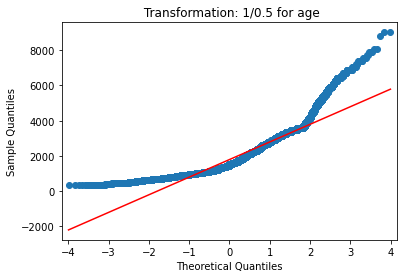

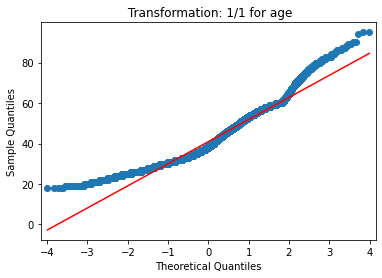

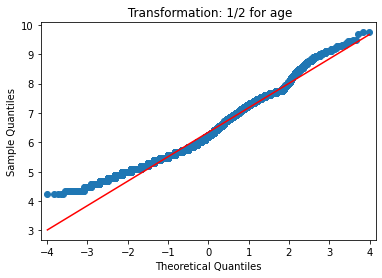

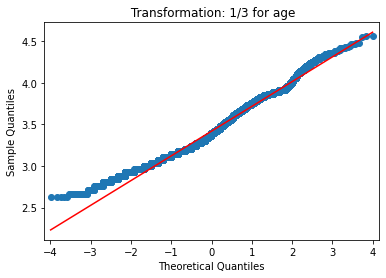

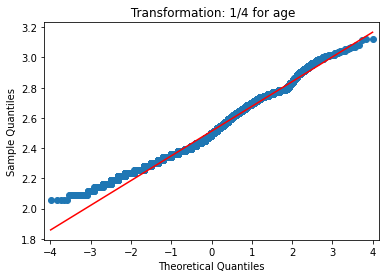

...

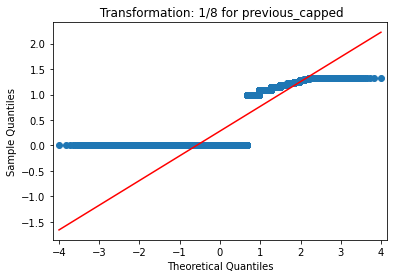

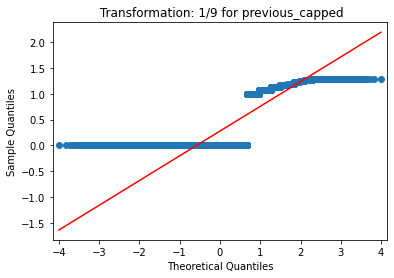

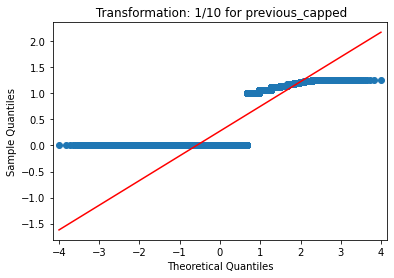

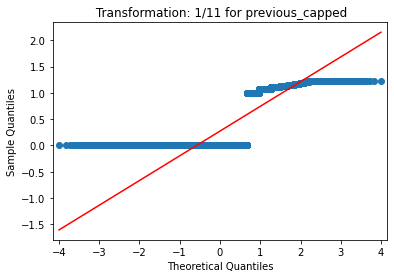

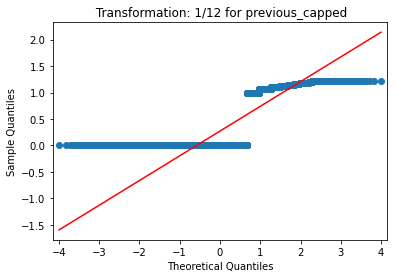

In [174]:
# Generate QQ plots for ech feature
for feat in ['age', 'age_capped', 'balance', 'balance_capped', 'duration', 'duration_capped','campaign', 'campaign_capped','pdays','pdays_capped','previous','previous_capped']:
    for i in [0.5, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
        data = banking_train[feat]**(1/i)
        qqplot(data, line='s')
        plt.title(f' Transformation: 1/{str(i)} for {feat}')

### A Box Cox transformation is a transformation of non-normal dependent variables into a normal shape. Normality is an important assumption for many statistical techniques; if your data isn’t normal, applying a Box-Cox means that you are able to run a broader number of tests.

- Stephanie Glen. "Box Cox Transformation: Definition, Examples" From StatisticsHowTo.com: Elementary Statistics for the rest of us! https://www.statisticshowto.com/box-cox-transformation/

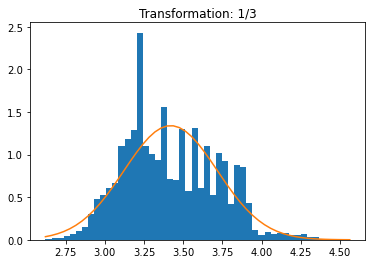

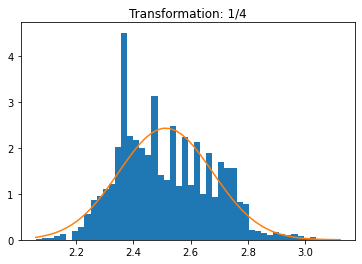

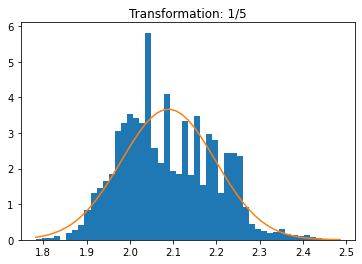

In [175]:
# Box-Cox transformation
import scipy
for i in [3,4,5]:
    data = banking_train['age']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

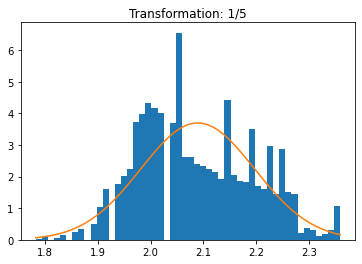

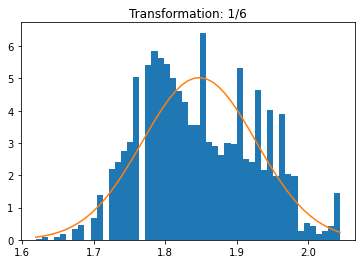

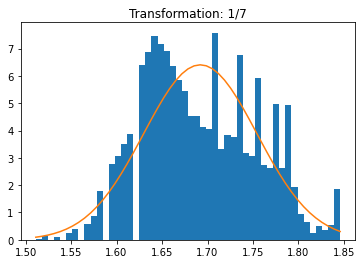

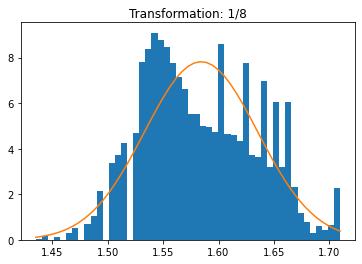

In [176]:
# Box-Cox transformation
for i in [5, 6, 7, 8]:
    data = banking_train['age_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

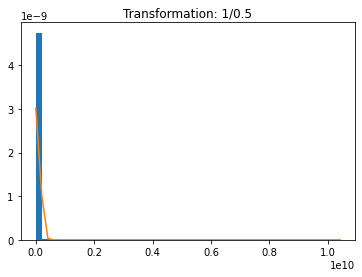

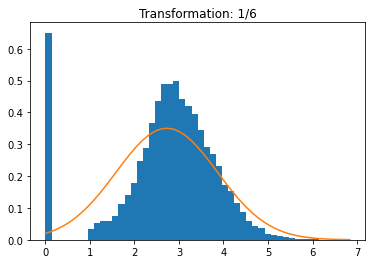

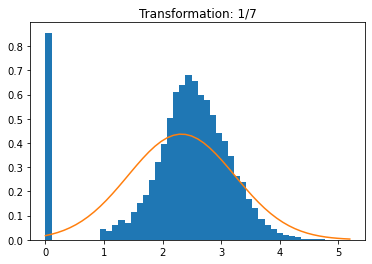

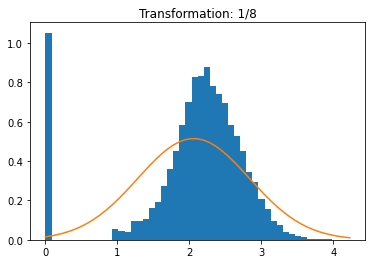

In [177]:

for i in [0.5, 6, 7, 8]:
    data = banking_train['balance']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

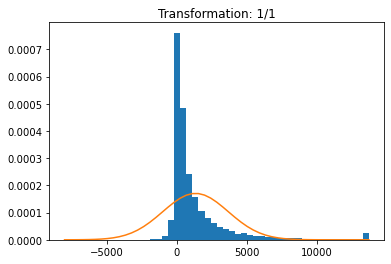

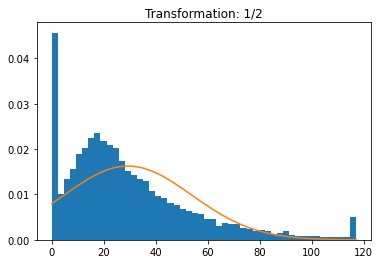

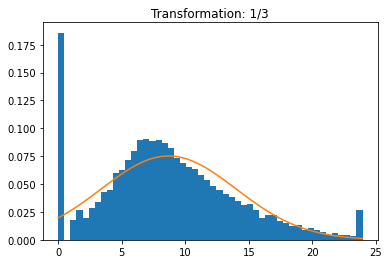

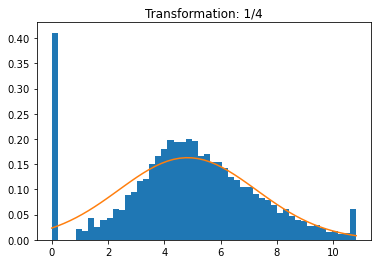

In [178]:
for i in [1, 2, 3, 4]:
    data = banking_train['balance_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

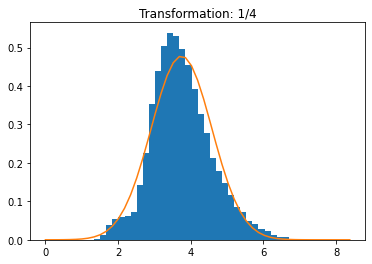

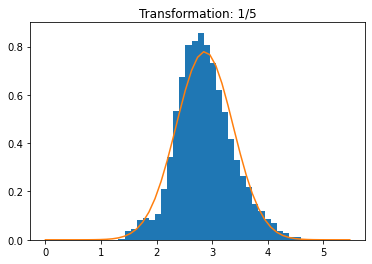

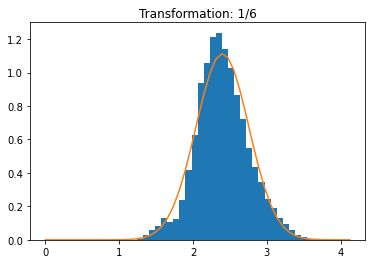

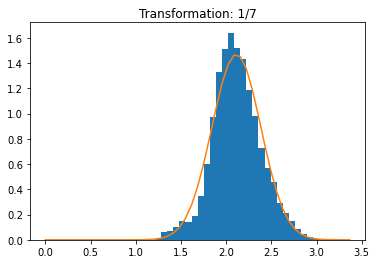

In [179]:
for i in [4,5,6,7]:
    data = banking_train['duration']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

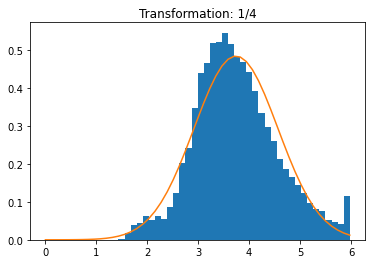

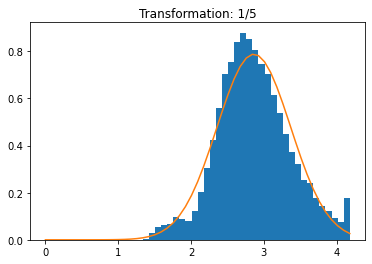

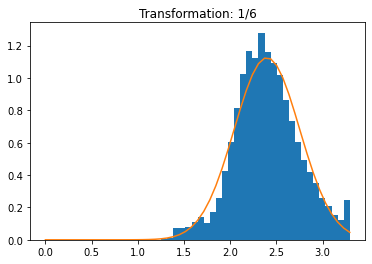

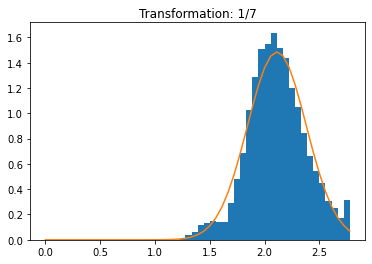

In [180]:
for i in [4,5,6,7]:
    data = banking_train['duration_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

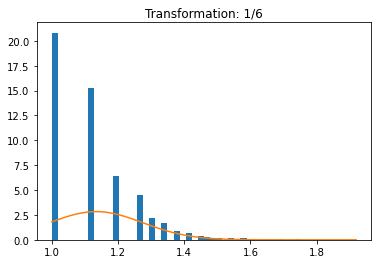

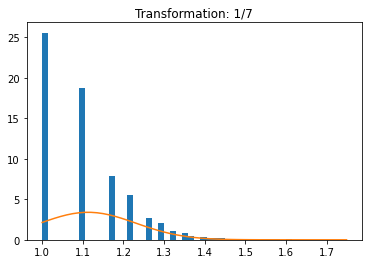

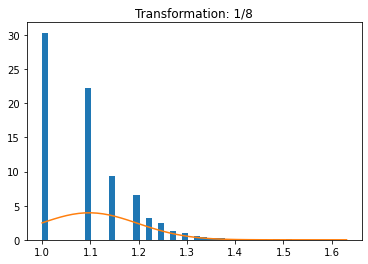

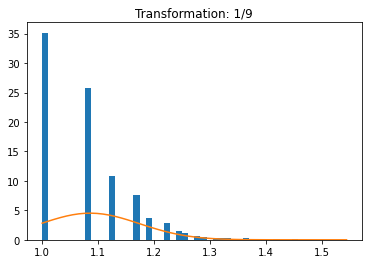

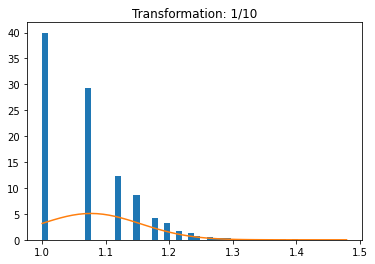

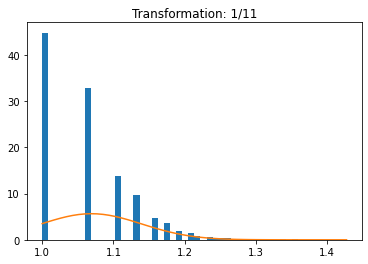

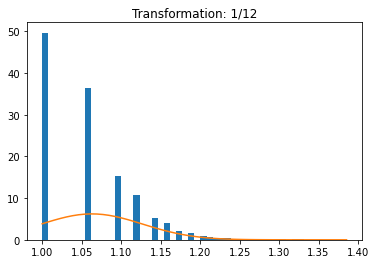

In [181]:
for i in [6, 7, 8, 9, 10, 11,12]:
    data = banking_train['campaign']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

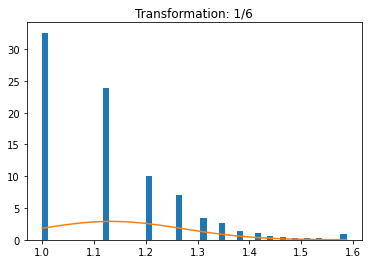

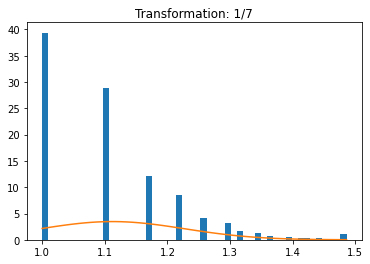

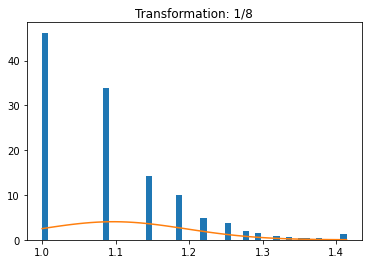

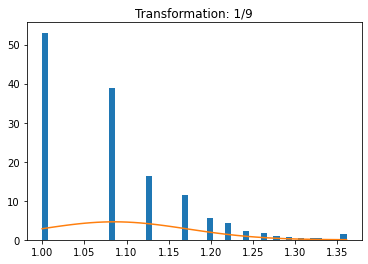

In [182]:
for i in [6, 7, 8, 9]:
    data = banking_train['campaign_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [ ]:
for i in [6, 7, 8, 9, 10, 11,12]:
    data = banking_train['pdays']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [ ]:
for i in [6, 7, 8, 9, 10, 11,12]:
    data = banking_train['pdays_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [ ]:
for i in [0.1,0.5,1, 2,4, 5, 6]:
    data = banking_train['previous']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [ ]:
for i in [0.1,0.5,1, 2]:
    data = banking_train['previous_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True)
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma))
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [188]:
# lets transform age, age capped, pdays, balance, balance_capped, duration, duration_capped, campaign, and campaign_capped
banking_train['age_transformed']= banking_train['age'].apply(lambda x:x**1/4)
banking_train['age_capped_transformed']= banking_train['age_capped'].apply(lambda x:x**1/6)
banking_train['pdays_transformed']= banking_train['pdays'].apply(lambda x:x**1/6)
banking_train['balance_transformed']= banking_train['balance'].apply(lambda x:x**1/6)
banking_train['balance_capped_transformed']= banking_train['balance_capped'].apply(lambda x:x**1/4)
banking_train['duration_transformed']= banking_train['duration'].apply(lambda x:x**1/5)
banking_train['duration_capped_transformed']= banking_train['duration_capped'].apply(lambda x:x**1/4)
banking_train['campaign_transformed']= banking_train['campaign'].apply(lambda x:x**1/10)
banking_train['campaign_capped_transformed']= banking_train['campaign_capped'].apply(lambda x:x**1/9)

In [189]:
banking_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30907 entries, 0 to 30906
Data columns (total 31 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   age                          30907 non-null  int64  
 1   job                          30907 non-null  object 
 2   marital                      30907 non-null  object 
 3   education                    30907 non-null  object 
 4   default                      30907 non-null  object 
 5   balance                      30907 non-null  int64  
 6   housing                      30907 non-null  object 
 7   loan                         30907 non-null  object 
 8   contact                      30907 non-null  object 
 9   day                          30907 non-null  int64  
 10  month                        30907 non-null  object 
 11  duration                     30907 non-null  int64  
 12  campaign                     30907 non-null  int64  
 13  pdays           

In [201]:
categorical.pop(8)

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'y']

In [202]:
# Lets convert categorical features to numeric
for feat in categorical:
    le = LabelEncoder()
    banking_train[feat]= le.fit_transform(banking_train[feat].astype(str))

In [203]:
# lets print out 10 random samplesto check if we successfully converted out categorical data to numerical
banking_train.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,...,previous_capped,age_transformed,age_capped_transformed,pdays_transformed,balance_transformed,balance_capped_transformed,duration_transformed,duration_capped_transformed,campaign_transformed,campaign_capped_transformed
24523,41,1,0,1,0,793,1,0,0,15,...,1.0,10.25,6.833333,60.833333,132.166667,198.25,24.6,30.75,0.1,0.111111
9047,47,10,1,1,0,644,0,0,1,21,...,0.0,11.75,7.833333,-0.166667,107.333333,161.00,33.8,42.25,1.3,1.444444
7816,55,8,1,1,0,-31,0,1,0,13,...,0.0,13.75,9.166667,-0.166667,-5.166667,-7.75,16.2,20.25,0.2,0.222222
10288,32,10,1,2,0,1868,0,0,0,27,...,0.0,8.00,5.333333,-0.166667,311.333333,467.00,37.2,46.50,1.6,1.777778
19025,33,5,1,2,0,110,1,1,0,17,...,0.0,8.25,5.500000,-0.166667,18.333333,27.50,25.0,31.25,0.4,0.444444
26508,41,5,1,2,0,254,0,0,0,9,...,2.0,10.25,6.833333,49.000000,42.333333,63.50,36.6,45.75,0.2,0.222222
30234,29,9,2,1,0,1377,1,0,0,3,...,2.0,7.25,4.833333,74.333333,229.500000,344.25,49.6,62.00,0.1,0.111111
20041,33,1,1,0,0,1002,1,0,0,20,...,4.0,8.25,5.500000,54.166667,167.000000,250.50,18.4,23.00,0.2,0.222222
16932,26,3,2,1,0,101,1,0,0,5,...,1.0,6.50,4.333333,44.666667,16.833333,25.25,162.0,202.50,0.1,0.111111
15140,27,10,1,1,0,2735,1,0,0,29,...,0.0,6.75,4.500000,-0.166667,455.833333,683.75,41.0,51.25,0.1,0.111111


In [204]:
# Lets save our data
banking_train.to_csv("/.../.../.../banking_train_numeric.csv", index=False)

In [205]:
banking_train= pd.read_csv("/.../.../.../banking_train_numeric.csv")

In [206]:
banking_train.sample(2)

,age,job,marital,education,default,balance,housing,loan,contact,day,...,previous_capped,age_transformed,age_capped_transformed,pdays_transformed,balance_transformed,balance_capped_transformed,duration_transformed,duration_capped_transformed,campaign_transformed,campaign_capped_transformed
8821,39,5,1,2,0,51,0,0,0,20,...,0.0,9.75,6.500000,-0.166667,8.500000,12.75,28.0,35.0,0.2,0.222222
29259,26,0,2,2,0,760,1,0,0,4,...,5.0,6.50,4.333333,46.833333,126.666667,190.00,91.2,114.0,0.2,0.222222


In [215]:
for variables in banking_train.columns:
    if variables =='poutcome':
        print(variables)
    else:
        pass

In [216]:
banking_train.shape

(30907, 31)

In [217]:
# features = x, label = y
features = banking_train.drop(['y'], axis=1)
labels= banking_train['y']

In [218]:
features.to_csv("/.../.../.../train_features.csv", index=False)
labels.to_csv("/.../.../.../train_labels.csv", index=False)

# Lets standarize our training data


In [219]:
train_features= pd.read_csv("/.../.../.../train_features.csv")

In [220]:
# lets standarize training data
scaler= StandardScaler()
scaler.fit(train_features)

StandardScaler()

In [221]:
features = train_features.columns
train_features[features]= scaler.transform(train_features[features])

In [222]:
train_features.sample(3)

,age,job,marital,education,default,balance,housing,loan,contact,day,...,previous_capped,age_transformed,age_capped_transformed,pdays_transformed,balance_transformed,balance_capped_transformed,duration_transformed,duration_capped_transformed,campaign_transformed,campaign_capped_transformed
6953,0.373643,0.030685,-0.293639,1.196964,-0.12953,1.081583,1.007176,-0.445589,-0.309011,-0.968475,...,-0.42691,0.373643,0.385620,-0.505165,1.081583,1.516823,-0.343258,-0.358647,-0.254308,-0.272732
12271,-0.541906,0.030685,-1.930633,1.196964,-0.12953,-0.193600,-0.992875,-0.445589,-0.309011,0.368651,...,-0.42691,-0.541906,-0.546281,-0.505165,-0.193600,-0.224322,-0.665238,-0.709496,-0.592790,-0.667418
2760,-0.816571,-1.125891,-1.930633,-0.311295,-0.12953,-0.298585,-0.992875,-0.445589,-0.309011,0.247094,...,-0.42691,-0.816571,-0.825851,-0.505165,-0.298585,-0.367670,0.230875,0.266965,-0.592790,-0.667418


In [223]:
# lets write out our standarized training set
train_features.to_csv("/.../.../.../train_features_standarized.csv", index=False)

In [224]:
train_features= pd.read_csv("/.../.../.../Banking Dataset/train_features_standarized.csv")

In [225]:
train_features.head(2)

,age,job,marital,education,default,balance,housing,loan,contact,day,...,previous_capped,age_transformed,age_capped_transformed,pdays_transformed,balance_transformed,balance_capped_transformed,duration_transformed,duration_capped_transformed,campaign_transformed,campaign_capped_transformed
0,-1.274345,0.030685,1.343356,-0.311295,-0.12953,-0.435850,-0.992875,-0.445589,-0.309011,-1.454702,...,-0.42691,-1.274345,-1.291802,-0.505165,-0.435850,-0.555093,-0.021278,-0.007797,-0.59279,-0.667418
1,1.197637,-1.125891,-0.293639,-1.819554,-0.12953,-0.300779,-0.992875,-0.445589,-0.309011,-1.454702,...,-0.42691,1.197637,1.224331,-0.505165,-0.300779,-0.370666,0.141652,0.169741,-0.59279,-0.667418


# <font color =Red> Test Set

# <font color = red> Lets explore and clean test set, then standarize it and split it to validation and test

In [2]:
banking_test= pd.read_csv("/.../.../.../banking_test.csv")

In [ ]:
banking_test.head()


    
------------------------------------------------


    
Shape of the data:
(4521, 17)
    
------------------------------------------------


    
 Null Values:
age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64 
    
------------------------------------------------


    
Distribution of the target variable y: has the client subscribed a term deposit? (binary: "yes","no"):
no     4000
yes     521
Name: y, dtype: int64
    
Visualizing the distribution
 
    


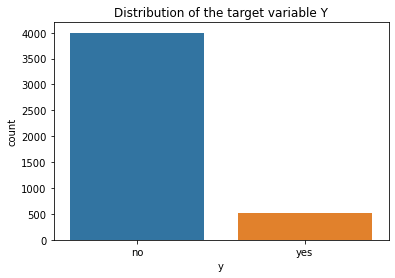


    
------------------------------------------------

    
Duplicated data:
0 
    
------------------------------------------------


    
 Empty strings:
(array([], dtype=int64), array([], dtype=int64))

    


In [5]:
# use same function EDA that I created earlier to explore banking test set
EDA(banking_test)

In [6]:
banking_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4521 entries, 0 to 4520
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        4521 non-null   int64 
 1   job        4521 non-null   object
 2   marital    4521 non-null   object
 3   education  4521 non-null   object
 4   default    4521 non-null   object
 5   balance    4521 non-null   int64 
 6   housing    4521 non-null   object
 7   loan       4521 non-null   object
 8   contact    4521 non-null   object
 9   day        4521 non-null   int64 
 10  month      4521 non-null   object
 11  duration   4521 non-null   int64 
 12  campaign   4521 non-null   int64 
 13  pdays      4521 non-null   int64 
 14  previous   4521 non-null   int64 
 15  poutcome   4521 non-null   object
 16  y          4521 non-null   object
dtypes: int64(7), object(10)
memory usage: 600.6+ KB


In [7]:
banking_test.describe()

,age,balance,day,duration,campaign,pdays,previous
count,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000
mean,41.170095,1422.657819,15.915284,263.961292,2.793630,39.766645,0.542579
std,10.576211,3009.638142,8.247667,259.856633,3.109807,100.121124,1.693562
min,19.000000,-3313.000000,1.000000,4.000000,1.000000,-1.000000,0.000000
25%,33.000000,69.000000,9.000000,104.000000,1.000000,-1.000000,0.000000
50%,39.000000,444.000000,16.000000,185.000000,2.000000,-1.000000,0.000000
75%,49.000000,1480.000000,21.000000,329.000000,3.000000,-1.000000,0.000000
max,87.000000,71188.000000,31.000000,3025.000000,50.000000,871.000000,25.000000


In [11]:
continous=[]
categorical=[]
for feature in banking_test.columns:
    if banking_test[feature].dtype  == 'int64':
        continous.append(feature)
    else:
        categorical.append(feature)

In [14]:
#lets explore continous features by dropping categorical feat and leave only continous
# Have already created a set for continous features (continous), and a set for categorical features (categorical)

banking_test.drop(categorical, axis=1, inplace=True)

In [15]:
# check if code did what we expect it to do
banking_test.head()

,age,balance,day,duration,campaign,pdays,previous
0,30,1787,19,79,1,-1,0
1,33,4789,11,220,1,339,4
2,35,1350,16,185,1,330,1
3,30,1476,3,199,4,-1,0
4,59,0,5,226,1,-1,0


In [16]:
# lets check for multiculinarity
banking_test.corr()

,age,balance,day,duration,campaign,pdays,previous
age,1.000000,0.083820,-0.017853,-0.002367,-0.005148,-0.008894,-0.003511
balance,0.083820,1.000000,-0.008677,-0.015950,-0.009976,0.009437,0.026196
day,-0.017853,-0.008677,1.000000,-0.024629,0.160706,-0.094352,-0.059114
duration,-0.002367,-0.015950,-0.024629,1.000000,-0.068382,0.010380,0.018080
campaign,-0.005148,-0.009976,0.160706,-0.068382,1.000000,-0.093137,-0.067833
pdays,-0.008894,0.009437,-0.094352,0.010380,-0.093137,1.000000,0.577562
previous,-0.003511,0.026196,-0.059114,0.018080,-0.067833,0.577562,1.000000


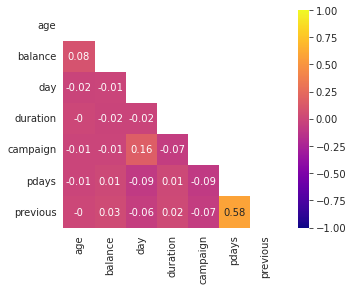

In [17]:
# lets visualize it for easier reading
mask = np.zeros_like(banking_test.corr(), dtype=bool)
mask[np.triu_indices_from(mask)]= True

with sns.axes_style("white"):
    ax = sns.heatmap(round(banking_test.corr(),2), mask=mask, vmin=-1, vmax=1, square=True, cmap='plasma', annot=True)

plt.show()

###  <font color = blue> - Pdays and previous are highly correlated (0.58)</font>

###  <font color = blue> - day and campaign are weakly associated (0.16) </font>

# Lets plot out continous features 

In [ ]:
for i in continous:
    fig=px.histogram(banking_test[i], x = i, marginal='box',nbins=10)
    fig.show()

- Not normally distributed, which what we concluded from checking the dataset describtion

# lets explore categorical features

In [19]:
banking_test= pd.read_csv("/.../.../.../Banking Dataset/banking_test.csv")

In [20]:
banking_test.drop(continous, axis=1, inplace=True)

In [ ]:
banking_test.head()

In [22]:
# lets check for null values 
banking_test.isnull().sum()

job          0
marital      0
education    0
default      0
housing      0
loan         0
contact      0
month        0
poutcome     0
y            0
dtype: int64

In [23]:
 # lets epxlore number of unique values for each caegotical feature
for col in banking_test.columns: 
    print(f"""{col} : has {banking_test[col].nunique()} Unique Value
                \n --Which are: {banking_test[col].unique()}\n
    
    """)

job : has 12 Unique Value
               
 --Which are: ['unemployed' 'services' 'management' 'blue-collar' 'self-employed'
 'technician' 'entrepreneur' 'admin.' 'student' 'housemaid' 'retired'
 'unknown']

   
   
marital : has 3 Unique Value
               
 --Which are: ['married' 'single' 'divorced']

   
   
education : has 4 Unique Value
               
 --Which are: ['primary' 'secondary' 'tertiary' 'unknown']

   
   
default : has 2 Unique Value
               
 --Which are: ['no' 'yes']

   
   
housing : has 2 Unique Value
               
 --Which are: ['no' 'yes']

   
   
loan : has 2 Unique Value
               
 --Which are: ['no' 'yes']

   
   
contact : has 3 Unique Value
               
 --Which are: ['cellular' 'unknown' 'telephone']

   
   
month : has 12 Unique Value
               
 --Which are: ['oct' 'may' 'apr' 'jun' 'feb' 'aug' 'jan' 'jul' 'nov' 'sep' 'mar' 'dec']

   
   
poutcome : has 4 Unique Value
               
 --Which are: ['unknown' 'failure' 'othe

# We see that Job, Education , poutcome, and contact have unknowns- will replace with nan

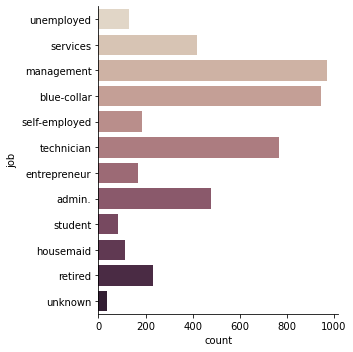

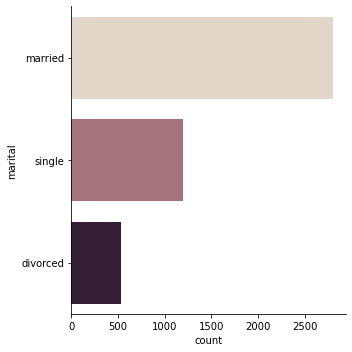

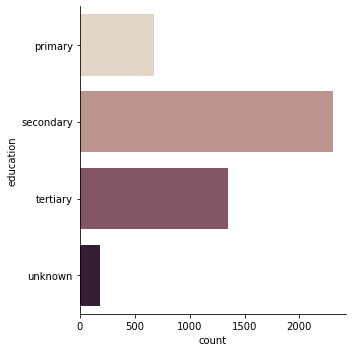

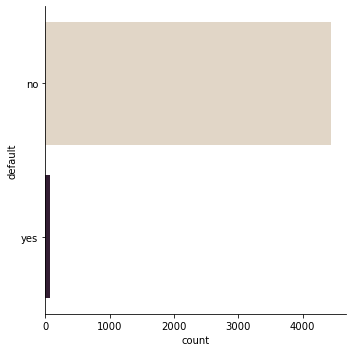

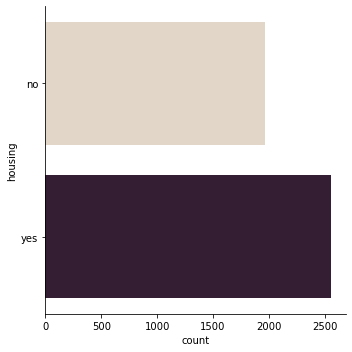

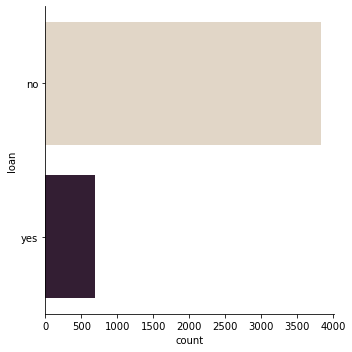

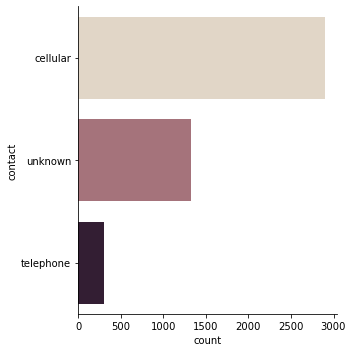

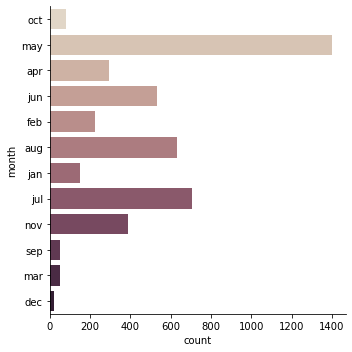

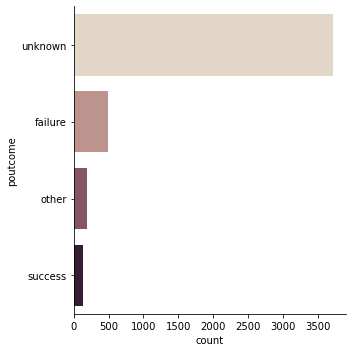

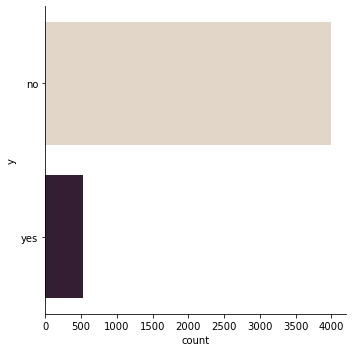

In [24]:
for feature in banking_test.columns:
    sns.catplot(y=feature, kind='count', palette='ch:.25', data=banking_test)

# <font color =Blue> contact and poutcome have so many unknowns</font>

# Cramer’s V Correlation Matrix
- Lets check for multiculinarity btw categorical features using Cramers V correlation matrix

In [25]:
label = LabelEncoder()
data_encoded = pd.DataFrame()

In [26]:
for feature in banking_test.columns:
    data_encoded[feature]= label.fit_transform(banking_test[feature])

In [27]:
data_encoded.head()

,job,marital,education,default,housing,loan,contact,month,poutcome,y
0,10,1,0,0,0,0,0,10,3,0
1,7,1,1,0,1,1,0,8,0,0
2,4,2,2,0,1,0,0,0,0,0
3,4,1,2,0,1,1,2,6,3,0
4,1,1,1,0,1,0,2,8,3,0


In [28]:
 #Cramer V function
def cramers_V(var1,var2) :
    crosstab =np.array(pd.crosstab(var1,var2, rownames=None, colnames=None)) # Cross tablulation x2 = chi2_contingency(crosstab)[0] # Keeping of the test statistic of the Chi2 test
    x2 = chi2_contingency(crosstab)[0] # Keeping of the test statistic of the Chi2 test
    n= np.sum(crosstab)
    phi2= x2/n
    r, k =crosstab.shape
    phi2corr= max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [29]:
rows= []

for var1 in data_encoded:
    col = []
    for var2 in data_encoded :
        cramers =cramers_V(data_encoded[var1], data_encoded[var2]) # Cramer's V test
        col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V  
    rows.append(col)

cramers_results = np.array(rows)
banking_test = pd.DataFrame(cramers_results, columns = data_encoded.columns, index =data_encoded.columns)




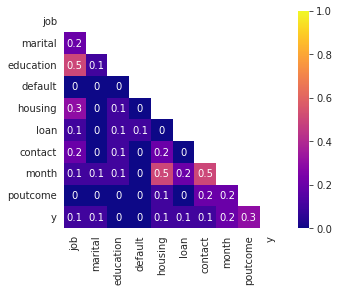

In [31]:
mask = np.zeros_like((round(banking_test,1)), dtype=bool)
mask[np.triu_indices_from(mask)] = True




with sns.axes_style("white"):
    ax = sns.heatmap((round(banking_test,1)), mask=mask,vmin=0., vmax=1, square=True, cmap = 'plasma',annot= True)
plt.savefig("/.../.../.../img/Cramer's V Before cleaning_testSet.png")
plt.show()

In [32]:
banking_test= pd.read_csv("/.../.../.../banking_test.csv")

In [33]:
banking_test.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,no
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,may,220,1,339,4,failure,no
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,apr,185,1,330,1,failure,no
3,30,management,married,tertiary,no,1476,yes,yes,unknown,3,jun,199,4,-1,0,unknown,no
4,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,may,226,1,-1,0,unknown,no


In [34]:
banking_test['job']= banking_test['job'].replace('unknown', np.nan)

In [35]:
banking_test['education']= banking_test['education'].replace('unknown', np.nan)

In [36]:
banking_test['poutcome']= banking_test['poutcome'].replace('unknown', np.nan)

In [37]:
banking_test['contact']= banking_test['contact'].replace('unknown', np.nan)

In [39]:
banking_test.isnull().sum()

age             0
job            38
marital         0
education     187
default         0
balance         0
housing         0
loan            0
contact      1324
day             0
month           0
duration        0
campaign        0
pdays           0
previous        0
poutcome     3705
y               0
dtype: int64

In [40]:
banking_test.shape

(4521, 17)

# <font color =Brown> Before treating null values lets check if they are:</font>
- Missing Completly at random (MCAR): Missing completely at random; there is no relationship between existing values and missing values 

- or Missingness at Random (MAR): 

- or Not missing at random (NMAR):

<AxesSubplot:>

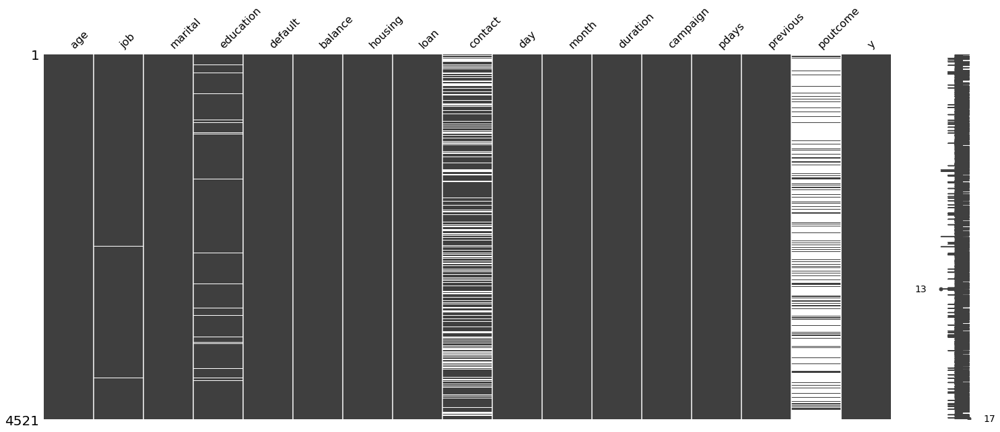

In [41]:
msno.matrix(banking_test.sample(4521))

<AxesSubplot:>

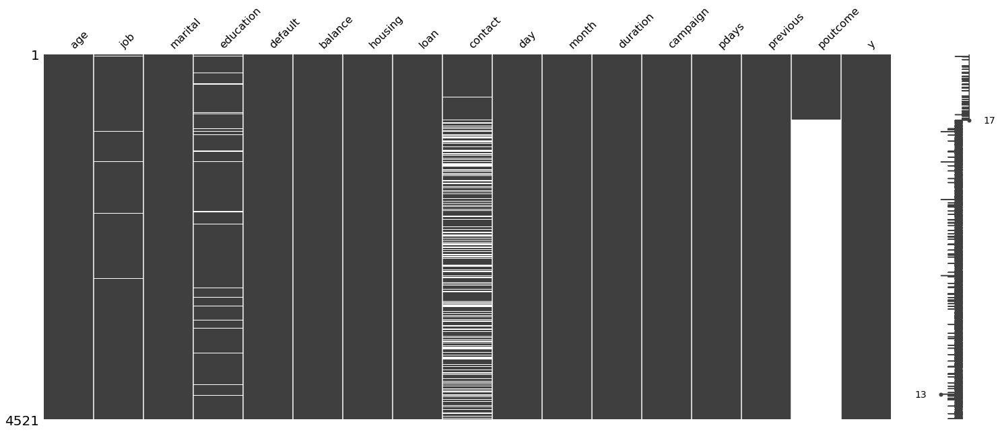

In [44]:
msno.matrix(banking_test.sort_values('poutcome'))

<AxesSubplot:>

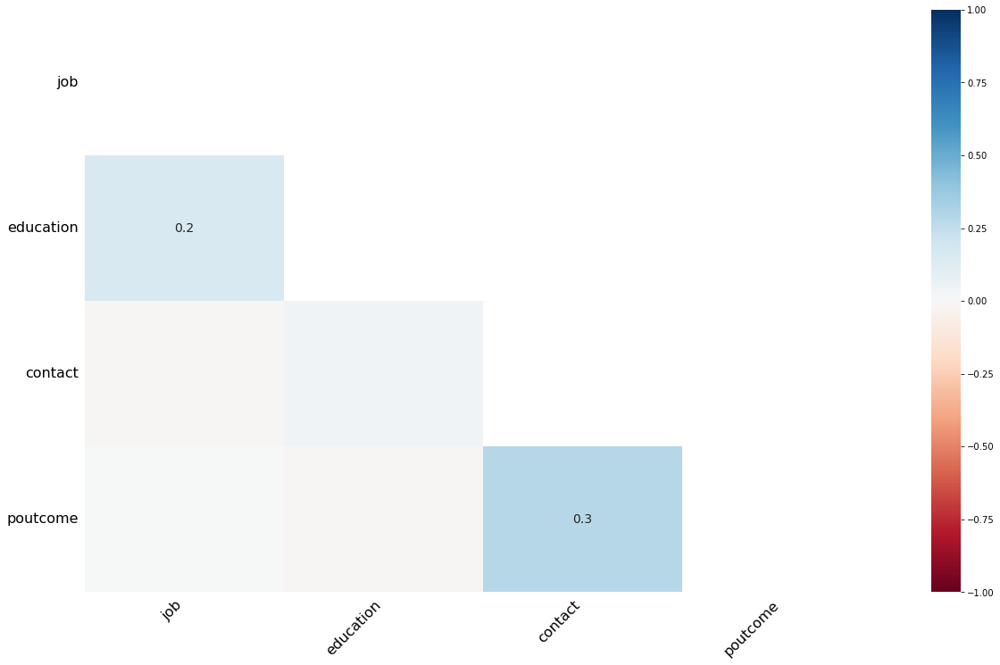

In [45]:
msno.heatmap(banking_test)

<AxesSubplot:>

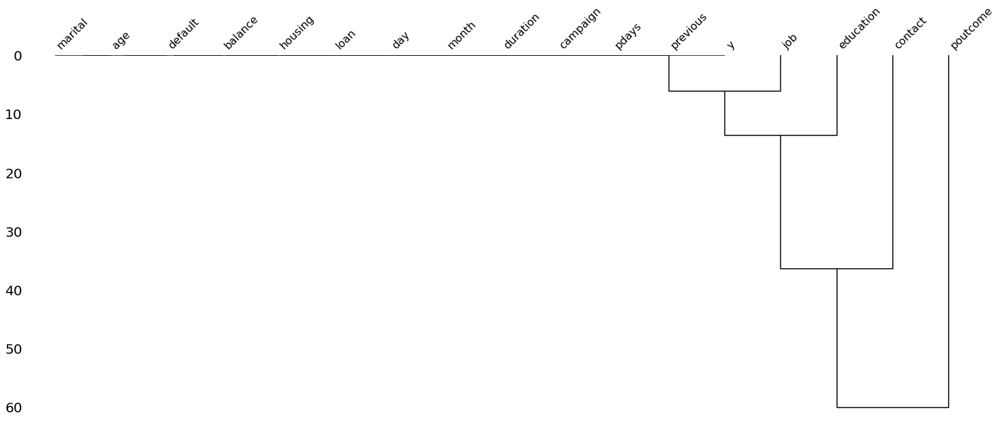

In [47]:
msno.dendrogram(banking_test)

# Missing at random

In [48]:
for feature in banking_test:
    if pd.isna(banking_test[feature]).sum() > 0:
        print(f'{feature} has {banking_test[feature].isnull().sum()}')
   

job has 38
education has 187
contact has 1324
poutcome has 3705


In [49]:
# will drop poutcome as it has so many missing values
banking_test.drop('poutcome', axis=1, inplace= True)

In [50]:
# for the rest, we treat missing values by dropping any rows with missing values 
banking_test.dropna(axis=0, how='any',inplace=True)

In [ ]:
banking_test.shape

In [52]:
banking_test.to_csv("/.../.../.../banking_test_imputed.csv", index=False)

# Lets re examine categorical features after Cleaning Null values

In [53]:
banking_test=pd.read_csv("/.../.../...banking_test_imputed.csv")

In [55]:
banking_test.drop(continous, axis=1, inplace=True)

In [56]:
banking_test.columns

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'y'],
      dtype='object')

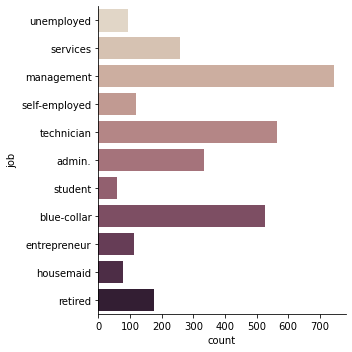

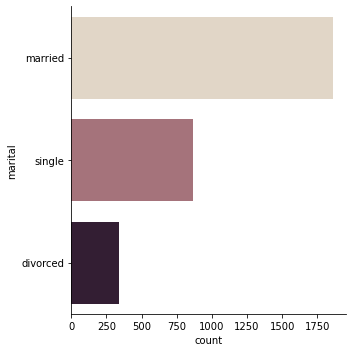

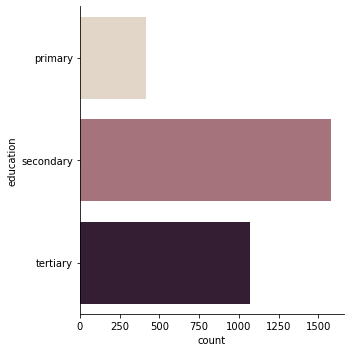

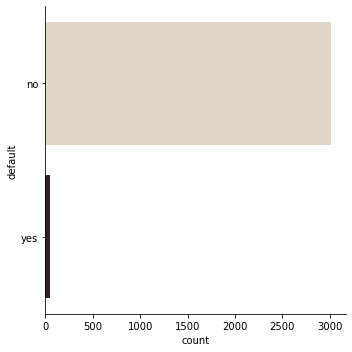

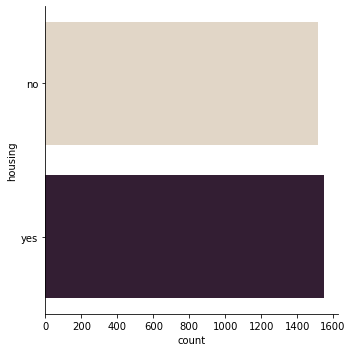

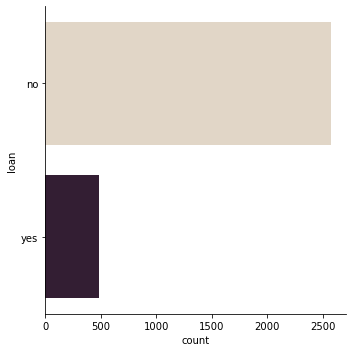

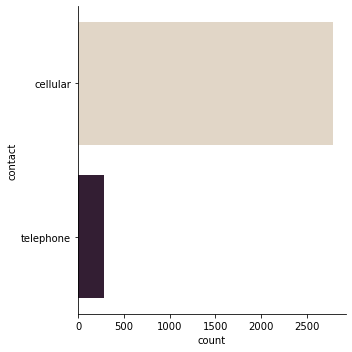

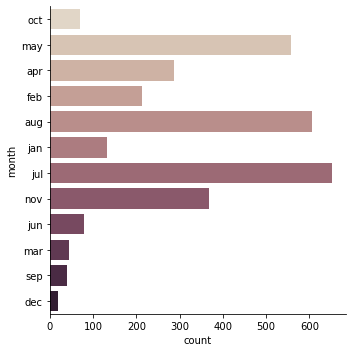

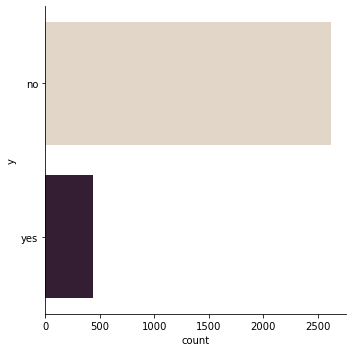

In [58]:
for features in banking_test.columns:
    sns.catplot(y=features, kind='count', palette='ch:.25', data=banking_test)

In [59]:
label=LabelEncoder()
data_encoded=pd.DataFrame()

In [60]:
for feature in banking_test.columns:
    data_encoded[feature]= label.fit_transform(banking_test[feature])

In [61]:
# lets check to see if successeded in encoding our catgorical feat
data_encoded.head()

,job,marital,education,default,housing,loan,contact,month,y
0,10,1,0,0,0,0,0,10,0
1,7,1,1,0,1,1,0,8,0
2,4,2,2,0,1,0,0,0,0
3,4,2,2,0,0,0,0,3,0
4,6,1,2,0,1,0,0,8,0


In [62]:
#Cramer V function
def cramers_V(var1,var2) :
    crosstab =np.array(pd.crosstab(var1,var2, rownames=None, colnames=None)) # Cross tablulation 
    x2 = chi2_contingency(crosstab)[0] # Keeping of the test statistic of the Chi2 test
    n= np.sum(crosstab)
    phi2= x2/n
    r, k =crosstab.shape
    phi2corr= max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1) 
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

In [63]:
rows= []

for var1 in data_encoded:
    col = []
    for var2 in data_encoded :
        cramers =cramers_V(data_encoded[var1], data_encoded[var2]) # Cramer's V test
        col.append(round(cramers,2)) # Keeping of the rounded value of the Cramer's V  
    rows.append(col)

cramers_results = np.array(rows)
banking_test = pd.DataFrame(cramers_results, columns = data_encoded.columns, index =data_encoded.columns)



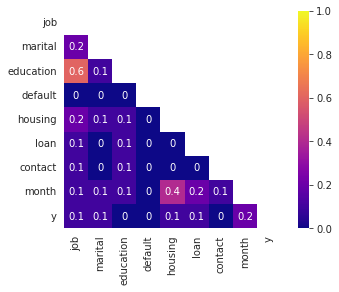

In [64]:
mask = np.zeros_like((round(banking_test,1)), dtype=bool)
mask[np.triu_indices_from(mask)] = True




with sns.axes_style("white"):
    fig = sns.heatmap((round(banking_test,1)), mask=mask,vmin=0., vmax=1, square=True, cmap = 'plasma',annot= True)
plt.savefig("/.../.../.../img/Cramer's V after cleaning_banking_test.png")
plt.show()

# Before

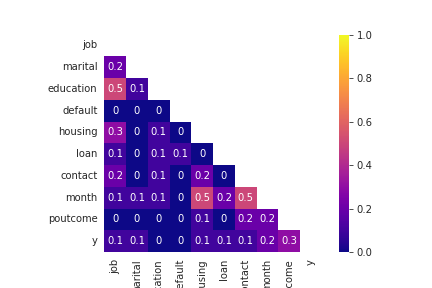

# After

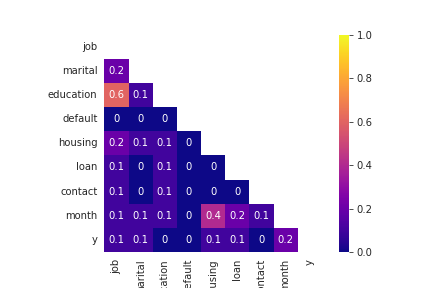

- Association btw job and education increased fom 0.5 to 0.6
- Association btw housing and month decrease from 0.5 to 0.4
- Association btw contact and month decreased from 0.5 to 0.1
- Association btw housing and job decreased from 0.3 to 0.2
- Association btw target variabel (y) and contact decreased from 0.1 to no associassion at all(0)


In [65]:
banking_test.isnull().sum()

job          0
marital      0
education    0
default      0
housing      0
loan         0
contact      0
month        0
y            0
dtype: int64

In [66]:
banking_test=pd.read_csv("/.../.../.../banking_test_imputed.csv")

# Using Z-score and BoxPlot to Detect Outliers


In [67]:
# Adapted from Derek Jedamski
def detect_outlier(feature): 
    outliers = []
    data = banking_test[feature] 
    mean = np.mean(data)
    std = np.std(data)

    for y in data:
        z_score = (y - mean)/std 
        if np.abs(z_score) > 3:
            outliers.append(y)

    print(f'\nOutlier caps for {feature}:')
    print(f' 95p: {data.quantile(.95)}')
    print(f' 3sd: {mean + 3*(std)}' )
    print(f' 99p: {data.quantile(.99)}')
    print(f'\nOutlier floor for {feature}:')
    print(f' 0.5p: {data.quantile(.05)}')
    print(f' 3sd: {mean - 3*(std)}')
    print(f' 1: {data.quantile(.01)}')
    fig = px.histogram(banking_train, x =feature, marginal='box') 
    fig.show()

In [68]:
# Determine what the upperbound and lowerbound should be for continous features
for feat in continous: 
    detect_outlier(feat)      


Outlier caps for age:
 95p: 59.0
 3sd: 74.18074301546534
 99p: 75.0

Outlier floor for age:
 0.5p: 27.0
 3sd: 8.300327480618215
 1: 24.0



Outlier caps for balance:
 95p: 6483.0
 3sd: 10706.24838040436
 99p: 14070.949999999997

Outlier floor for balance:
 0.5p: -90.85
 3sd: -7801.9063438508365
 1: -640.5500000000001



Outlier caps for day:
 95p: 30.0
 3sd: 40.31460065276616
 99p: 31.0

Outlier floor for day:
 0.5p: 4.0
 3sd: -8.014992297674777
 1: 2.0



Outlier caps for duration:
 95p: 760.5499999999997
 3sd: 1031.4484229970758
 99p: 1277.5899999999992

Outlier floor for duration:
 0.5p: 38.150000000000006
 3sd: -500.63706529472586
 1: 11.0



Outlier caps for campaign:
 95p: 8.0
 3sd: 11.938333822258212
 99p: 15.0

Outlier floor for campaign:
 0.5p: 1.0
 3sd: -6.341075336618526
 1: 1.0



Outlier caps for pdays:
 95p: 342.0
 3sd: 393.6138695000322
 99p: 371.0

Outlier floor for pdays:
 0.5p: -1.0
 3sd: -283.0910235470296
 1: -1.0



Outlier caps for previous:
 95p: 4.0
 3sd: 6.646238011695752
 99p: 9.0

Outlier floor for previous:
 0.5p: 0.0
 3sd: -5.140363338066509
 1: 0.0


In [69]:
# lets cap:  balance, duration, campaign, pdays, previous at the 99p
banking_test['age_capped']= banking_test['age'].clip(upper=banking_test['age'].quantile(.99))
banking_test['balance_capped']= banking_test['balance'].clip(upper=banking_test['balance'].quantile(.99))
banking_test['duration_capped']= banking_test['duration'].clip(upper=banking_test['duration'].quantile(.99))
banking_test['campaign_capped']= banking_test['campaign'].clip(upper=banking_test['campaign'].quantile(.99))
banking_test['pdays_capped']= banking_test['pdays'].clip(upper=banking_test['pdays'].quantile(.99))
banking_test['previous_capped']= banking_test['previous'].clip(upper=banking_test['previous'].quantile(.99))

In [70]:
banking_test.describe()

,age,balance,day,duration,campaign,pdays,previous,age_capped,balance_capped,duration_capped,campaign_capped,pdays_capped,previous_capped
count,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000,3064.000000
mean,41.240535,1452.171018,16.149804,265.405679,2.798629,55.261423,0.752937,41.196475,1378.238071,262.325813,2.729112,54.214426,0.709204
std,10.981861,3085.195954,8.056247,255.389261,3.047065,112.802558,1.964754,10.832047,2437.390098,238.748638,2.540765,108.582245,1.641955
min,19.000000,-2082.000000,1.000000,5.000000,1.000000,-1.000000,0.000000,19.000000,-2082.000000,5.000000,1.000000,-1.000000,0.000000
25%,33.000000,66.750000,9.000000,106.750000,1.000000,-1.000000,0.000000,33.000000,66.750000,106.750000,1.000000,-1.000000,0.000000
50%,39.000000,457.500000,16.500000,186.000000,2.000000,-1.000000,0.000000,39.000000,457.500000,186.000000,2.000000,-1.000000,0.000000
75%,49.000000,1520.250000,21.000000,332.000000,3.000000,-1.000000,0.000000,49.000000,1520.250000,332.000000,3.000000,-1.000000,0.000000
max,87.000000,71188.000000,31.000000,3025.000000,50.000000,871.000000,25.000000,75.000000,14070.950000,1277.590000,15.000000,371.000000,9.000000


In [73]:
banking_test.to_csv("/.../.../.../banking_test_capped.csv", index=False)

In [74]:
banking_test= pd.read_csv("/.../.../.../banking_test_capped.csv")

In [75]:
banking_test.info() # to make sure we have all variables (original and capped)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3064 entries, 0 to 3063
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              3064 non-null   int64  
 1   job              3064 non-null   object 
 2   marital          3064 non-null   object 
 3   education        3064 non-null   object 
 4   default          3064 non-null   object 
 5   balance          3064 non-null   int64  
 6   housing          3064 non-null   object 
 7   loan             3064 non-null   object 
 8   contact          3064 non-null   object 
 9   day              3064 non-null   int64  
 10  month            3064 non-null   object 
 11  duration         3064 non-null   int64  
 12  campaign         3064 non-null   int64  
 13  pdays            3064 non-null   int64  
 14  previous         3064 non-null   int64  
 15  y                3064 non-null   object 
 16  age_capped       3064 non-null   float64
 17  balance_capped

In [ ]:
for feature in ['age', 'age_capped', 'balance', 'balance_capped', 'duration', 'duration_capped','campaign','campaign_capped','pdays','pdays_capped','previous','previous_capped']:
    fig = px.histogram(banking_test, x =feature, marginal='box')
    fig.show()

- capping improved the dist of the features less skewed but still transformatin needed 


# Transform Skewed Features
## Box-Cox Power Transformation

In [ ]:
# Generate QQ plots for ech feature
for feat in ['age', 'age_capped', 'balance', 'balance_capped', 'duration', 'duration_capped','campaign', 'campaign_capped','pdays','pdays_capped','previous','previous_capped']:
    for i in [0.5, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
        data = banking_test[feat]**(1/i)
        qqplot(data, line='s')
        plt.title(f' Transformation: 1/{str(i)} for {feat}')

In [79]:
import scipy as scipy

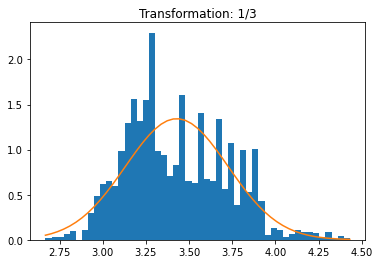

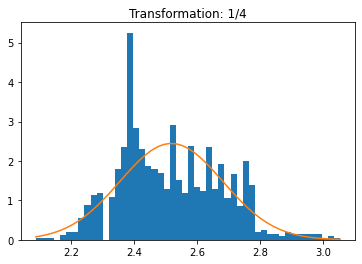

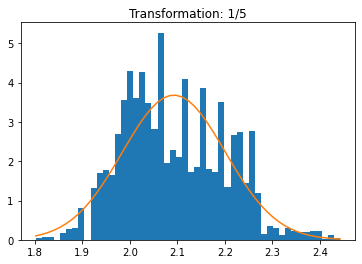

In [80]:
# Box-Cox transformation
for i in [3,4,5]:
    data = banking_test['age']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

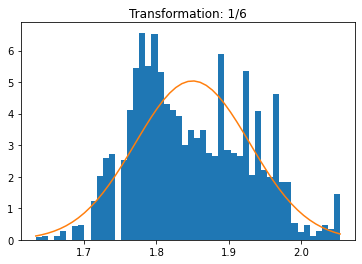

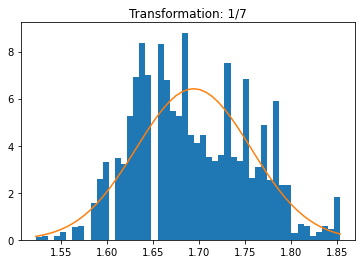

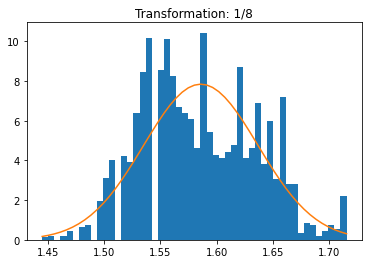

In [81]:
# Box-Cox transformation
for i in [6,7,8]:
    data = banking_test['age_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

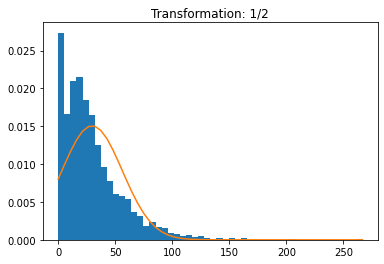

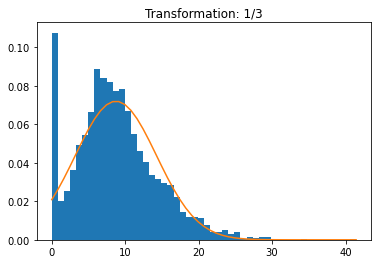

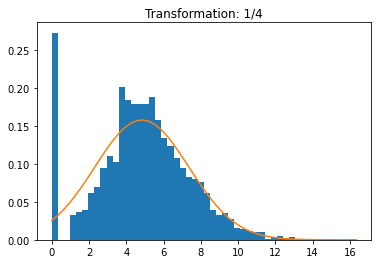

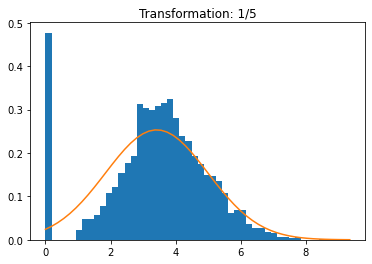

In [82]:
# Box-Cox transformation
for i in [2, 3, 4, 5]:
    data = banking_test['balance']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

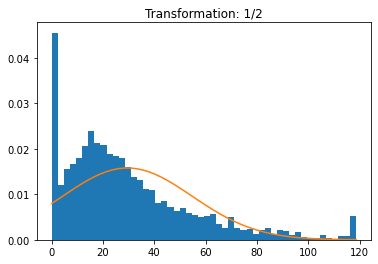

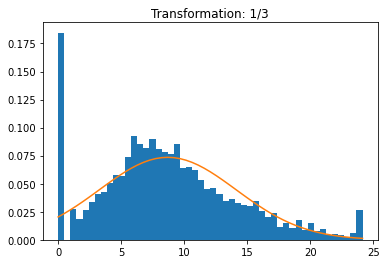

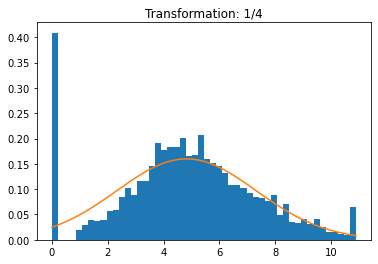

In [83]:
# Box-Cox transformation
for i in [ 2, 3, 4]:
    data = banking_test['balance_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

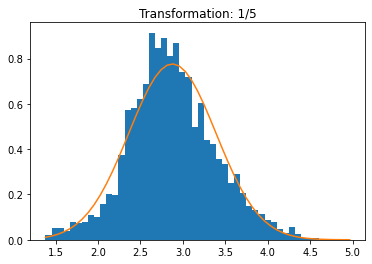

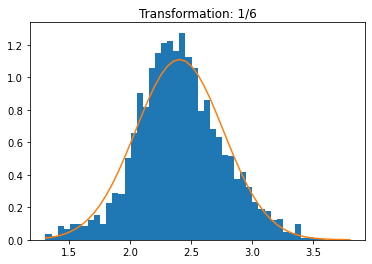

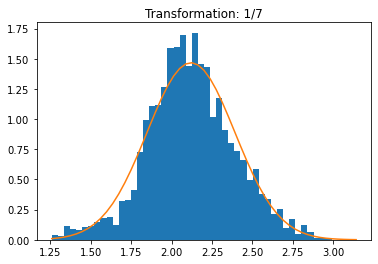

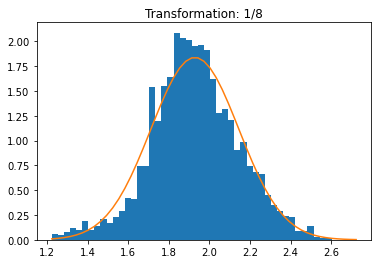

In [84]:
# Box-Cox transformation
for i in [5, 6, 7, 8]:
    data = banking_test['duration']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

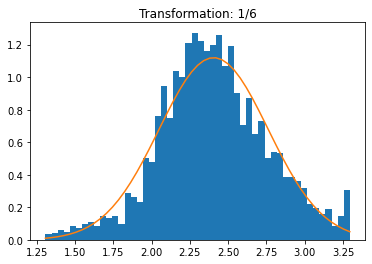

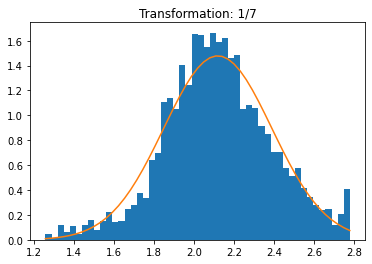

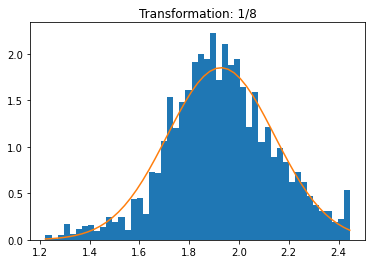

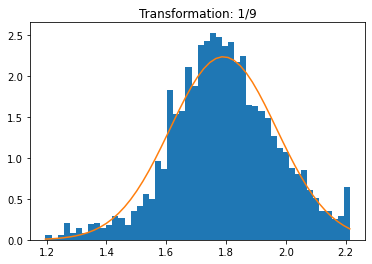

In [85]:
# Box-Cox transformation
for i in [6, 7, 8, 9]:
    data = banking_test['duration_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

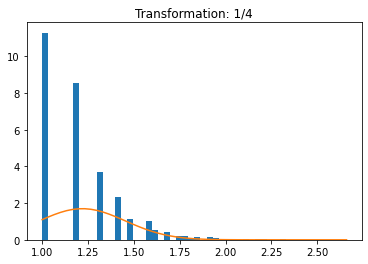

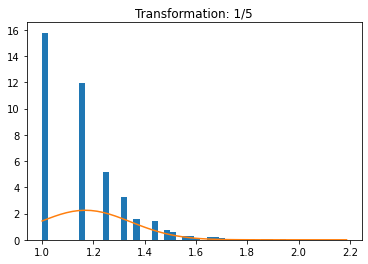

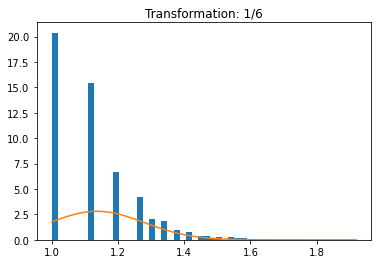

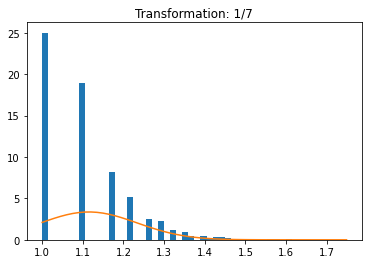

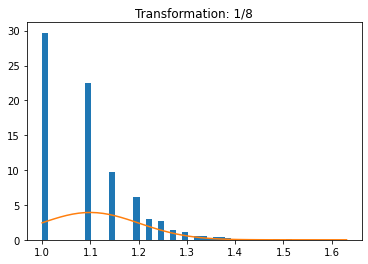

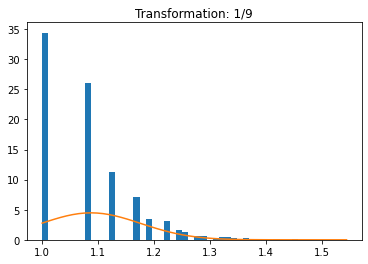

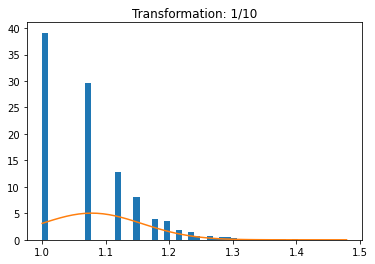

In [86]:
# Box-Cox transformation
for i in [4, 5, 6, 7, 8, 9, 10]:
    data = banking_test['campaign']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

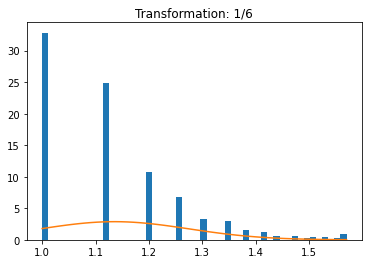

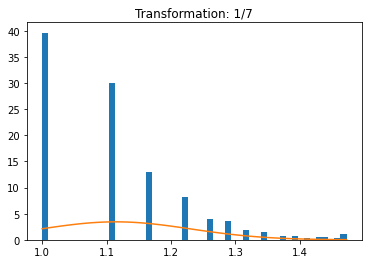

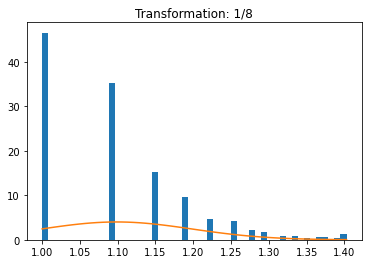

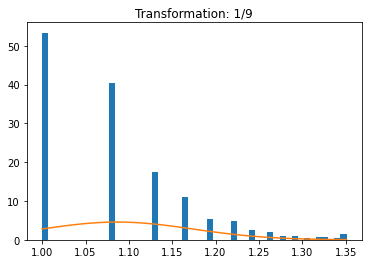

In [87]:
# Box-Cox transformation
for i in [6, 7, 8, 9]:
    data = banking_test['campaign_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

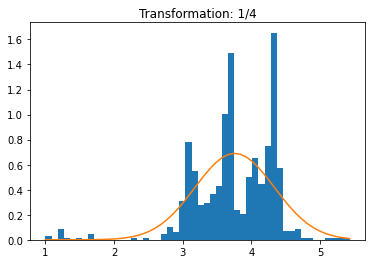

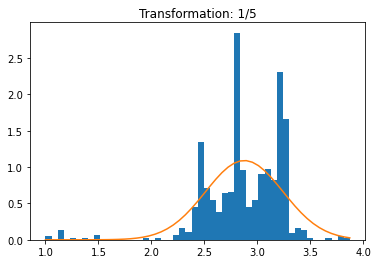

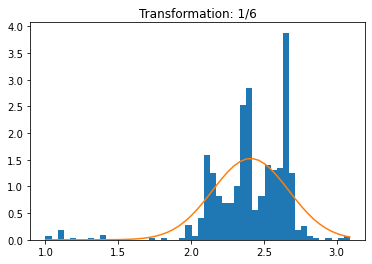

In [88]:
# Box-Cox transformation
for i in [ 4, 5, 6]:
    data = banking_test['pdays']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

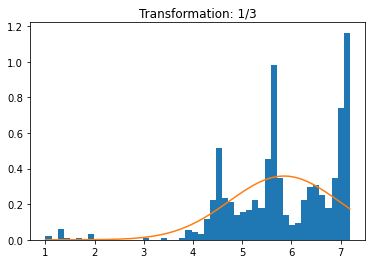

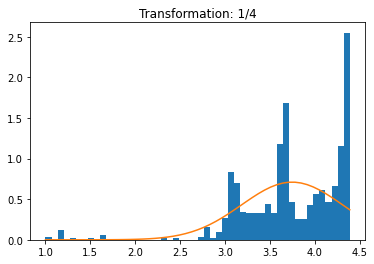

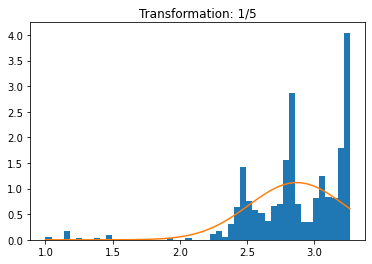

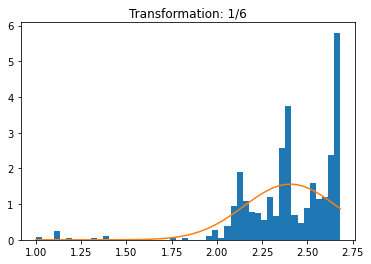

In [89]:
# Box-Cox transformation
for i in [3,4,5,6]:
    data = banking_test['pdays_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

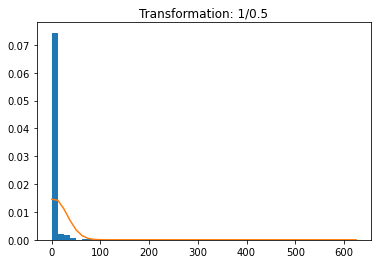

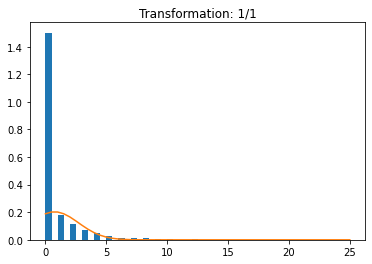

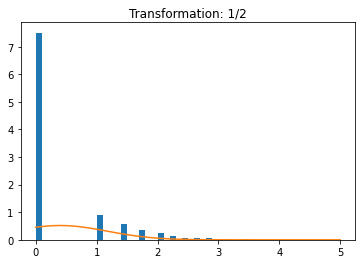

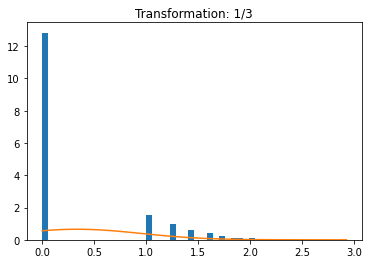

In [90]:
# Box-Cox transformation
for i in [0.5, 1, 2, 3]:
    data = banking_test['previous']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

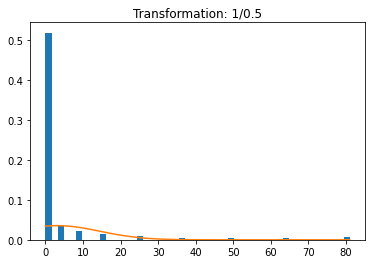

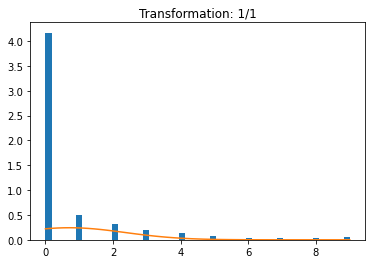

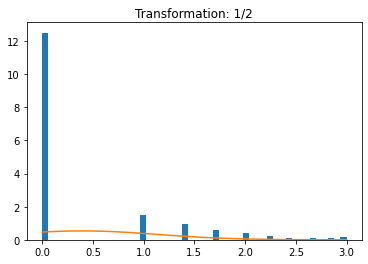

In [91]:
# Box-Cox transformation
for i in [0.5, 1, 2]:
    data = banking_test['previous_capped']**(1/i)
    n, bins, patches = plt.hist(data, 50, density=True) 
    mu = np.mean(data)
    sigma = np.std(data)
    plt.plot(bins, scipy.stats.norm.pdf(bins, mu, sigma)) 
    plt.title(f'Transformation: 1/{str(i)}')
    plt.show()

In [92]:
 # lets transform age, age capped, pdays, balance, balance_capped, duration,duration_capped, campaign, and campaign_capped
banking_test['age_transformed']= banking_test['age'].apply(lambda x:x**1/5) 
banking_test['age_capped_transformed']= banking_test['age_capped'].apply(lambda x:x**1/7)
banking_test['pdays_transformed']= banking_test['pdays'].apply(lambda x:x**1/6)
banking_test['balance_transformed']= banking_test['balance'].apply(lambda x:x**1/5)
banking_test['balance_capped_transformed']= banking_test['balance_capped'].apply(lambda x:x**1/4)
banking_test['duration_transformed']= banking_test['duration'].apply(lambda x:x**1/6)
banking_test['duration_capped_transformed']= banking_test['duration_capped'].apply(lambda x:x**1/8)
banking_test['campaign_transformed']= banking_test['campaign'].apply(lambda x:x**1/10)
banking_test['campaign_capped_transformed']= banking_test['campaign_capped'].apply(lambda x:x**1/9)

In [93]:
banking_test.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,previous_capped,age_transformed,age_capped_transformed,pdays_transformed,balance_transformed,balance_capped_transformed,duration_transformed,duration_capped_transformed,campaign_transformed,campaign_capped_transformed
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,...,0.0,6.0,4.285714,-0.166667,357.4,446.75,13.166667,9.875,0.1,0.111111
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,...,4.0,6.6,4.714286,56.500000,957.8,1197.25,36.666667,27.500,0.1,0.111111
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,...,1.0,7.0,5.000000,55.000000,270.0,337.50,30.833333,23.125,0.1,0.111111
3,35,management,single,tertiary,no,747,no,no,cellular,23,...,3.0,7.0,5.000000,29.333333,149.4,186.75,23.500000,17.625,0.2,0.222222
4,36,self-employed,married,tertiary,no,307,yes,no,cellular,14,...,2.0,7.2,5.142857,55.000000,61.4,76.75,56.833333,42.625,0.1,0.111111


In [97]:
categorical.pop(8)

'poutcome'

In [98]:
categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'y']

In [99]:
# lets convert categorical features to numerical
for feat in categorical:
    le = LabelEncoder()
    banking_test[feat]= le.fit_transform(banking_test[feat].astype(str))

In [ ]:
# lets print 5 random samples to make sure that the code did what intended to do
banking_test.sample(5)

In [101]:
# lets save our data
banking_test.to_csv("/.../.../.../banking_test_numeric.csv", index=False)

In [102]:
banking_test= pd.read_csv("/.../.../.../banking_test_numeric.csv")

In [103]:
features=banking_test.drop(['y'],axis=1)
labels= banking_test['y']

In [104]:
# now split test set into test and validation

x_val, x_test, y_val,  y_test  = train_test_split(features, labels, test_size=0.5, random_state=42)



In [ ]:
# let check to see if the dataset was splitted as wanted
for dataset in [x_val, x_test, y_val,  y_test ]:
    print(round(len(dataset)/len(labels),2))
print(x_val.shape)
print(x_test.shape)

In [ ]:
# lets write out datasets
x_test.to_csv("/.../.../.../partitioned dataset/test_features.csv", index=False)
x_val.to_csv("/.../.../.../partitioned dataset/val_features.csv", index=False)

y_test.to_csv("/.../.../.../partitioned dataset/test_labels.csv", index=False)
y_val.to_csv("/.../.../.../partitioned dataset/val_labels.csv", index=False)

In [ ]:
# lets standarize our test set
test_features= pd.read_csv("/.../.../.../partitioned dataset/test_features.csv")
val_features= pd.read_csv("/.../.../.../partitioned dataset/val_features.csv")

In [ ]:
scaler= StandardScaler()

In [ ]:
scaler.fit(test_features)

In [ ]:
features= test_features.columns
test_features[features]= scaler.transform(test_features[features])

In [ ]:
test_features.sample(5)

In [ ]:
# lets write out our standarized training set
test_features.to_csv("/.../.../.../test_features_standarized.csv", index=False)

In [ ]:
scaler.fit(val_features)

In [ ]:
features= val_features.columns
val_features[features]= scaler.transform(val_features[features])

In [ ]:
val_features.to_csv("/.../.../.../val_features_standarized.csv", index=False)

# <font color = green> Treating Imbalanced Data</font>



# Trainning set

## 1- TomekLinks

In [ ]:
train_features = pd.read_csv("/.../.../.../train_features_standarized.csv")
train_labels = pd.read_csv("/.../.../.../train_labels.csv")

In [ ]:
train_features.info()

In [ ]:
tl= TomekLinks(sampling_strategy='majority')
train_features_tl, train_labels_tl= tl.fit_resample(train_features,train_labels)


In [ ]:
print('Original dataset:',train_labels.value_counts())
sns.countplot(train_labels['y'])
plt.show()
print('Resampled dataset:',train_labels_tl.value_counts())
sns.countplot(train_labels_tl['y'])

# 2 - NearMiss
### NearMiss is under-sampling technique. Instead of resampling the minority class using a distance, this will make the majority class equal to minority

In [124]:
nm = NearMiss()

train_features_nm, train_labels_nm= nm.fit_resample(train_features,train_labels)


In [ ]:
print('Original dataset:',train_labels.value_counts())
sns.countplot(train_labels['y'])
plt.show()
print('Resampled dataset:',train_labels_nm.value_counts())
sns.countplot(train_labels_nm['y'])

# 3- SMOTE

### SMOTE
 It stands for Synthetic Minority Over-sampling Technique. It is a type of data augumentation that synthesize new sample from existing ones.It selects samples in the minority class that are close and then draws lines between them. New Sample points are located on these lines. SMOTE operate as follows: a randome sample is chosen, and then a KNN algorithm is used to select neighbours to which lines a re drawn. with this procedure; so you may create as many synthetic samples as needed.  

In [ ]:
# train set
sm= SMOTE(random_state=42)
train_features_sm, train_labels_sm=sm.fit_resample(train_features, train_labels)


print('Original dataset:',train_labels.value_counts())
sns.countplot(train_labels['y'])
plt.show()
print('Resampled dataset:',train_labels_sm.value_counts())
sns.countplot(train_labels_nm['y'])



# Untreated-Imbalanced data

In [127]:
train_features = pd.read_csv("/.../.../.../train_features_standarized.csv")
train_labels = pd.read_csv("/.../.../.../train_labels.csv")

# Validation 

In [128]:
val_features= pd.read_csv("/.../.../.../val_features_standarized.csv")

val_labels= pd.read_csv("/.../.../.../partitioned dataset/val_labels.csv")

## 1- TomekLinks

In [129]:
tl= TomekLinks(sampling_strategy='majority')
val_features_tl, val_labels_tl= tl.fit_resample(val_features,val_labels)



In [ ]:
print('Original dataset:',val_labels.value_counts())
sns.countplot(val_labels['y'])
plt.show()
print('Resampled dataset:',val_labels_tl.value_counts())
sns.countplot(val_labels_tl['y'])

# 2 - NearMiss


In [131]:

nm = NearMiss()

val_features_nm, val_labels_nm= nm.fit_resample(val_features,val_labels)



In [ ]:
print('Original dataset:',val_labels.value_counts())
sns.countplot(val_labels['y'])
plt.show()
print('Resampled dataset:',val_labels_nm.value_counts())
sns.countplot(val_labels_nm['y'])

## 3- SMOTE

In [ ]:
# SMOTE validation set
sm = SMOTE(random_state=42)
val_features_sm, val_labels_sm = sm.fit_resample(val_features, val_labels)

print('Original dataset:',val_labels.value_counts())
sns.countplot(train_labels['y'])
plt.show()
print('Resampled dataset:',val_labels_sm.value_counts())
sns.countplot(val_labels_sm['y'])

# Test

In [134]:
test_features= pd.read_csv("/.../.../.../test_features_standarized.csv")

test_labels= pd.read_csv("/.../.../.../partitioned dataset/test_labels.csv")

## 1- TomekLinks

In [135]:
tl= TomekLinks(sampling_strategy='majority')
test_features_tl, test_labels_tl= tl.fit_resample(test_features,test_labels)




In [ ]:
print('Original dataset:',test_labels.value_counts())
sns.countplot(test_labels['y'])
plt.show()
print('Resamples dataset:',test_labels_tl.value_counts())
sns.countplot(test_labels_tl['y'])

## 2- NearMiss

In [137]:

nm = NearMiss()

test_features_nm, test_labels_nm= nm.fit_resample(test_features,test_labels)




In [ ]:
print('Original dataset:',test_labels.value_counts())
sns.countplot(test_labels['y'])
plt.show()
print('Resamples dataset:',test_labels_nm.value_counts())
sns.countplot(test_labels_nm['y'])

## 3- SMOTE

In [ ]:
# SMOTE on tets set
sm= SMOTE(random_state=42)
test_features_sm, test_labels_sm=sm.fit_resample(test_features, test_labels)

print('Original dataset:',test_labels.value_counts())
sns.countplot(test_labels['y'])
plt.show()
print('Resamples dataset:',test_labels_sm.value_counts())
sns.countplot(test_labels_sm['y'])

# Lets define list of features

- There is a strong correlation btw pdays and previous. Consider dropping it to see how that will effect the results when we test our model performance on this test set

- housing and month weakly correlated

- month and contact are weakly correlated.

In [156]:
# original features with no cleaning
original_features= ['age','job','marital', 'education', 'default','balance', 'housing','loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous']

# original_reduced: drop feature that I suspect it degrades the performance of my model. dropped  pdays and previous
original_reduced = ['age','job','marital', 'education', 'default','balance', 'housing','loan', 'contact','month', 'day', 'duration', 'campaign']

# clean capped features: contains capped features
clean_capped_features =['age_capped','job','marital', 'education', 'default','balance_capped', 'housing','loan', 'contact', 'day', 'duration_capped', 'campaign_capped', 'pdays_capped', 'previous_capped']

# clean trans features contain transoformed features 
clean_trans_features= ['age_transformed','job','marital', 'education', 'default','balance_transformed', 'housing','loan', 'contact', 'day', 'duration_transformed', 'campaign_transformed', 'pdays', 'previous', 'month']

# clean_reduced_trans_features: drop pdays and previous, month
clean_trans_features_reduced =['age_transformed','job','marital', 'education', 'default','balance_transformed', 'housing','loan', 'contact', 'day', 'duration_transformed', 'campaign_transformed']


#clean_cap_tran_features contain features that I capped then transformed 
clean_cap_tran_features=['age_capped_transformed','job','marital', 'education', 'default','balance_capped_transformed', 'housing','loan', 'contact', 'day', 'month', 'duration_capped_transformed', 'campaign_capped_transformed', 'pdays', 'previous']


#clean_cap_tran_features_reduced: drop month, pdays and previous
clean_cap_tran_features_reduced=['age_capped_transformed','job','marital', 'education', 'default','balance_capped_transformed', 'housing',  'day', 'duration_capped_transformed', 'campaign_capped_transformed']

